In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '3'
import torch
from diffusion.diffusion_utils import build_diffusion_process
from modules.encoder import build_encoder_model
from modules.denoising_models import ConditionalDenosingMLP, build_denoising_model
import matplotlib.pyplot as plt
from matplotlib import colormaps
import scanpy as sc
from datasets.cxg_datasets import PatientDataset, AutoregPatientDataset
from tqdm import tqdm
from umap import UMAP
import numpy as np
import json
import os
from argparse import Namespace
import scanpy as sc
from diffusion.diffusion_evalmetrics import mmd, ot_sinkhorn
from sklearn.decomposition import PCA
import seaborn as sns
import pandas as pd
import anndata as ad
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import KNeighborsClassifier

In [2]:
# for saving figures
sc.set_figure_params(dpi_save=300)
plt.rcParams['pdf.fonttype'] = 42  # Ensures text remains editable in PDFs
plt.rcParams['svg.fonttype'] = 'none'  # Keeps text selectable in SVGs


In [3]:
# set seed for reproducibility
torch.manual_seed(0)

In [90]:
def add_cell_type_general_col_obs(obs):
    
    # create new column as copy of cell_type
    obs['cell_type_general'] = obs.cell_type.copy().astype('str')
    
    # group and rename
    obs.loc[['naive thymus-derived CD4-positive, alpha-beta T cell' in i for i in obs.cell_type_general],"cell_type_general"] = "naive T cell"
    obs.loc[['naive thymus-derived CD8-positive, alpha-beta T cell' in i for i in obs.cell_type_general],"cell_type_general"] = "naive T cell"
    obs.loc[[a and b for a,b in zip(['T cell' in i for i in obs.cell_type_general], ['naive' not in i for i in obs.cell_type_general])],"cell_type_general"] = "T cell" # T cells, but not naive
    obs.loc[['T-helper' in i for i in obs.cell_type_general],"cell_type_general"] = "T-helper"
    obs.loc[[a and b for a,b in zip(['B cell' in i for i in obs.cell_type_general], ['naive' not in i for i in obs.cell_type_general])],"cell_type_general"] = "B cell" # B cells, but not naive
    obs.loc[['epithelial cell' in i for i in obs.cell_type_general],"cell_type_general"] = "epithelial cell"
    obs.loc[['endothelial cell' in i for i in obs.cell_type_general],"cell_type_general"] = "endothelial cell"
    obs.loc[['monocyte' in i for i in obs.cell_type_general],"cell_type_general"] = "monocyte"
    obs.loc[['thymocyte' in i for i in obs.cell_type_general],"cell_type_general"] = "thymocyte"
    obs.loc[['macrophage' in i for i in obs.cell_type_general],"cell_type_general"] = "macrophage"
    obs.loc[['fibroblast' in i for i in obs.cell_type_general],"cell_type_general"] = "fibroblast"
    obs.loc[['smooth muscle cell' in i for i in obs.cell_type_general],"cell_type_general"] = "smooth muscle cell"
    obs.loc[['dendritic cell' in i for i in obs.cell_type_general],"cell_type_general"] = "dendritic cell"
    obs.loc[['precursor cell' in i for i in obs.cell_type_general],"cell_type_general"] = "progenitor cell"
    obs.loc[['multipotent cell' in i for i in obs.cell_type_general],"cell_type_general"] = "progenitor cell"
    obs.loc[['stem cell' in i for i in obs.cell_type_general],"cell_type_general"] = "progenitor cell"
    obs.loc[['natural killer cell' in i for i in obs.cell_type_general],"cell_type_general"] = "natural killer cell"
    obs.loc[['plasmacytoid dendritic cell' in i for i in obs.cell_type_general],"cell_type_general"] = "plasmacytoid dendritic cell"

    #to string, to remove unused categories from color palette
    obs.cell_type_general = obs.cell_type_general.astype('str')

    return obs

# visualize test patients

In [5]:
with open(os.path.join('/data/rna_rep_learning/scset/outputs/params/incredible-silver-bird-499-cell_transformer-diffusion-hlcatrinary_hvlatents.json'), "rb") as f:
    args_dict = json.load(f)
args = Namespace()
args.__dict__.update(args_dict)

In [6]:
args.annots_dir = "annotations_scvi"
args.patient_csv = "patient_index.csv"
args.pretrain_embedding = "scvi"

### create dataset

In [7]:
folder = '/data/rna_rep_learning/cellxgene_census_20240701'
autoreg_test_dataset = AutoregPatientDataset(folder=args.pretrain_data_cache, pretrain_embedding=args.pretrain_embedding, min_num_cells=args.min_num_cells, max_num_cells=args.max_num_cells,
                                                num_anchor_cells=args.num_anchor_cells, num_target_cells=args.num_target_cells, preload=True, split_col="random_fold", split_ids=[9],
                                                 annots_dir=args.annots_dir, patient_csv=args.patient_csv,
                                                annots_to_load=['cell_type','disease','tissue','tissue_general','patient_id','assay','dataset_id'],
                                                latent_idx_tokeep=args.latent_idx_tokeep)

Number of patients with at least 128 cells: 703
Preloading patients...


100%|██████████| 703/703 [00:01<00:00, 460.84it/s]


### create model

In [8]:
sample_dim = autoreg_test_dataset[0]['anchor'].shape[-1]
denoise_model = build_denoising_model(args, sample_dim)
encoder = build_encoder_model(args, sample_dim)
dp = build_diffusion_process(args)

In [9]:
model_dicts = torch.load(f'/data/rna_rep_learning/scset/outputs/checkpoints/incredible-silver-bird-499-cell_transformer-diffusion-hlcatrinary_hvlatents/pretrained.pt')
encoder_dict = model_dicts['encoder']
denoise_dict = model_dicts['denoise']

encoder.load_state_dict(encoder_dict)
denoise_model.load_state_dict(denoise_dict)

/tmp/ipykernel_2789091/933142293.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_dicts = torch.load(f'/data/rna_rep_learning/scset/outputs/checkpoints/incredible-s

<All keys matched successfully>

In [10]:
encoder = encoder.cuda()
denoise_model = denoise_model.cuda()
dp = dp.cuda()

### load test data

In [11]:
len(autoreg_test_dataset)

703

In [12]:
test_loader = torch.utils.data.DataLoader(autoreg_test_dataset, batch_size=len(autoreg_test_dataset), shuffle=True, num_workers=0, collate_fn=autoreg_test_dataset.collate_fn)

In [13]:
test_data = next(iter(test_loader))

In [14]:
test_annots = test_data['annotations']

In [15]:
# find test patients with >5 cell types (cell type considered present if has at least 30 cells)
ncells_per_ct_per_patient = test_annots.groupby(['tissue_general','disease','tissue','patient_id','cell_type']).size().reset_index(name='ncells')
ncells_per_ct_per_patient = ncells_per_ct_per_patient[ncells_per_ct_per_patient.ncells > 30]
test_pts_w_geq_5cts = ncells_per_ct_per_patient.groupby('patient_id').size().sort_values(ascending=False).index[ncells_per_ct_per_patient.groupby('patient_id').size().sort_values(ascending=False)>=5]
selected_test_annots = test_annots[test_annots.patient_id.isin(test_pts_w_geq_5cts)]
selected_test_annots[['disease','tissue','tissue_general','patient_id']].drop_duplicates().tissue_general.value_counts()

tissue_general
blood                     224
lung                       45
brain                      44
kidney                     25
breast                     20
heart                      18
small intestine            13
eye                        10
colon                       7
bone marrow                 7
adipose tissue              6
liver                       6
respiratory system          5
mucosa                      4
fallopian tube              4
stomach                     4
nose                        4
esophagus                   3
pancreas                    3
central nervous system      2
spinal cord                 2
digestive system            2
placenta                    1
lamina propria              1
skin of body                1
large intestine             1
uterus                      1
musculature                 1
lymph node                  1
Name: count, dtype: int64

In [16]:
len(test_pts_w_geq_5cts)

465

In [17]:
# get data and limit to our selected patients

anchor_cells = test_data['anchor'].cuda()
anchor_mask = test_data['anchor_mask'].cuda()
# annots is "selected_test_annots" in this analysis
annots = selected_test_annots

# limit the data to the selected patients which have significant numbers of >5 cell types
anchor_cells = anchor_cells[selected_test_annots.idx_in_batch.unique(),:,:]
anchor_mask = anchor_mask[selected_test_annots.idx_in_batch.unique(),:]

In [18]:
anchor_cell_annots = annots[annots.target_or_anchor=="anchor"]

In [19]:
# want the option to only color common cell types, so we can read the legend better
common_cts = anchor_cell_annots.cell_type.value_counts().sort_values(ascending=False).index[:30]
anchor_cell_annots['cell_type_common'] = [ct if ct in common_cts else 'Other' for ct in anchor_cell_annots.cell_type]

/tmp/ipykernel_2789091/2725543017.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  anchor_cell_annots['cell_type_common'] = [ct if ct in common_cts else 'Other' for ct in anchor_cell_annots.cell_type]


### generate cells for test patients

In [20]:
NUM_DIFFUSED_CELLS = 500

In [21]:
NUM_PATIENTS = anchor_cells.shape[0]

In [22]:
patient_embedding = encoder(anchor_cells, X_mask=anchor_mask.cuda()) # num_patients x model_dim

patient_embedding_repeated = patient_embedding.repeat_interleave(NUM_DIFFUSED_CELLS, dim=0)

diffused_cells, intermediate_steps = dp.p_sample(denoise_model, (NUM_PATIENTS*NUM_DIFFUSED_CELLS, anchor_cells.shape[-1]), condition=patient_embedding_repeated, return_intermediate_steps=True)
diffused_cells = diffused_cells.cpu()
diffused_cells = diffused_cells.reshape(NUM_PATIENTS, NUM_DIFFUSED_CELLS, -1)

In [23]:
# only keep anchor cells that are not masked for viz
true_cells = anchor_cells.cpu().flatten(0,1)[~anchor_mask.cpu().flatten(0,1).bool()]
len(true_cells)

458171

## visualize intermediate steps as UMAPs for paper

### setup

In [24]:
true_adata = ad.AnnData(true_cells.numpy(), obs = anchor_cell_annots)
true_adata.obsm['scvi'] = true_cells.numpy()
#sc.pp.neighbors(true_adata, use_rep="scvi")
#sc.tl.umap(true_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [25]:
# create coarser cell type col
true_adata.obs = add_cell_type_general_col_obs(true_adata.obs.copy())

In [26]:
diffused_cell_annots = annots[['disease','tissue','tissue_general','patient_id','idx_in_batch']].drop_duplicates().reset_index(drop=True)
diffused_cell_annots = diffused_cell_annots.iloc[np.repeat(diffused_cell_annots.index, NUM_DIFFUSED_CELLS)].reset_index(drop=True)
diffused_cell_annots
diffused_cell_annots.idx_in_batch = diffused_cell_annots.idx_in_batch.astype(str)

### lung

In [145]:
tis = "lung"

In [146]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


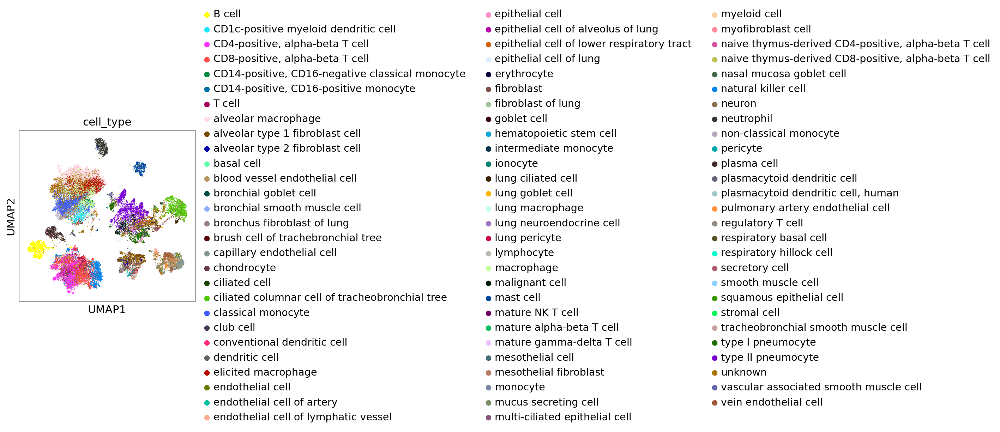

In [147]:
sc.pl.umap(tis_adata, color="cell_type")

In [148]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [149]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


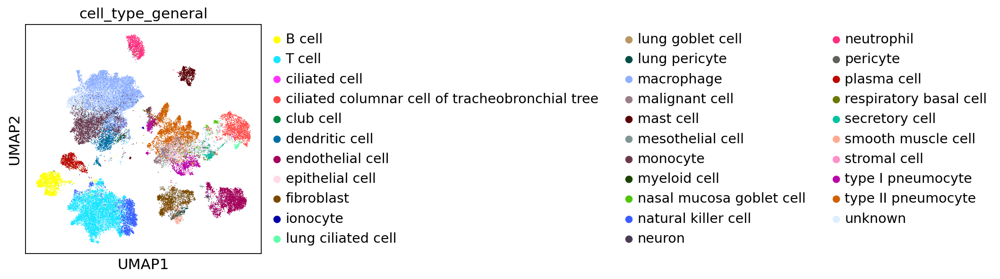

In [150]:
sc.pl.umap(tis_adata, color="cell_type_general")

#### set up diffused lung adata with annots + assign cell types using KNN

In [151]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [152]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [153]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(true_adata.obsm['scvi'], true_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffused, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [154]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [155]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure cell type cats match so that legend colors are the same for true and diffused umaps

In [156]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(true_adata.obs['cell_type_general'].astype("category").cat.categories)
tis_adata.obs['cell_type_general'] = tis_adata.obs['cell_type_general'].astype("category").cat.set_categories(true_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2789091/1899525649.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(true_adata.obs['cell_type_general'].astype("category").cat.categories)
/tmp/ipykernel_2789091/1899525649.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  tis_adata.obs['cell_type_general'] = tis_adata.obs['cell_type_general'].astype("category").cat.set_categories(true_adata.obs['cell_type_general'].astype("category").cat.categories)
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/a

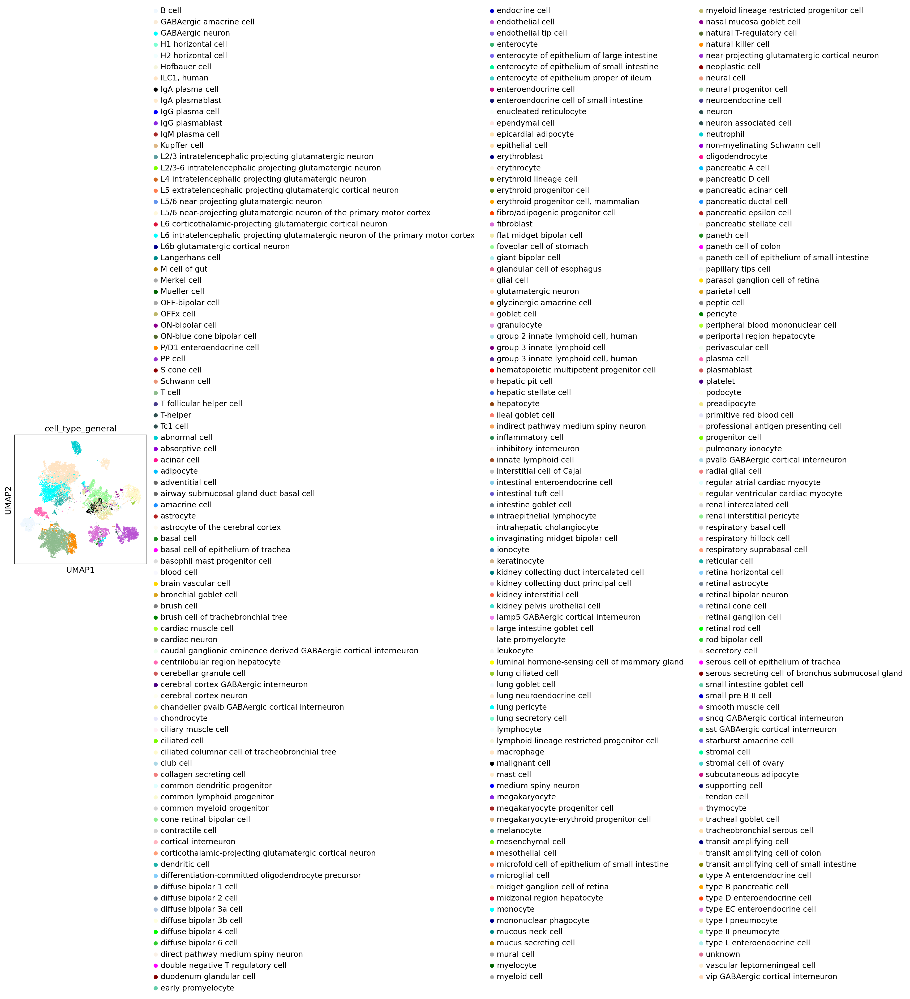

In [157]:
import matplotlib
sc.pl.umap(tis_adata, color="cell_type_general", palette=list(matplotlib.colors.CSS4_COLORS.values()))

#### viz true data

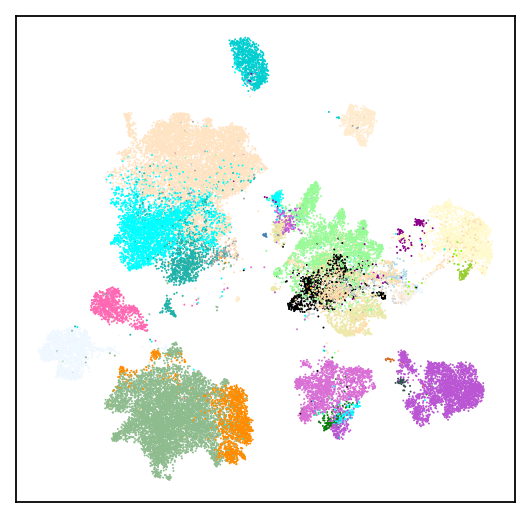

In [40]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", palette=list(matplotlib.colors.CSS4_COLORS.values()), return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
#plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
#plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

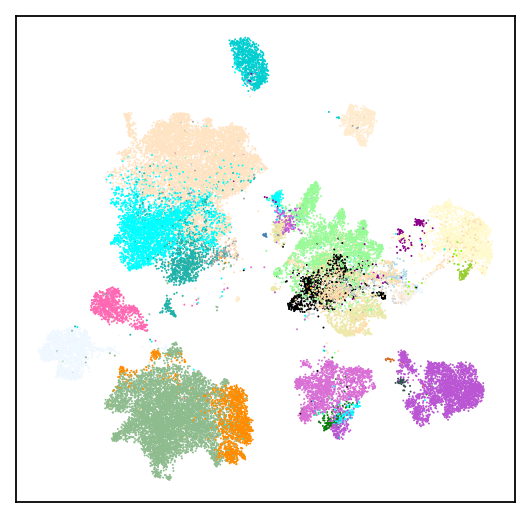

In [41]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these lung samples

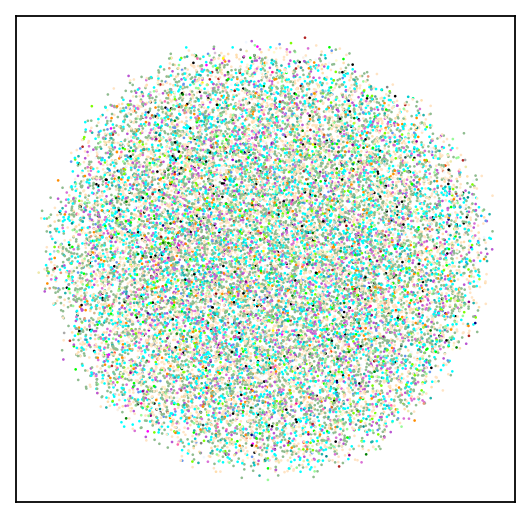

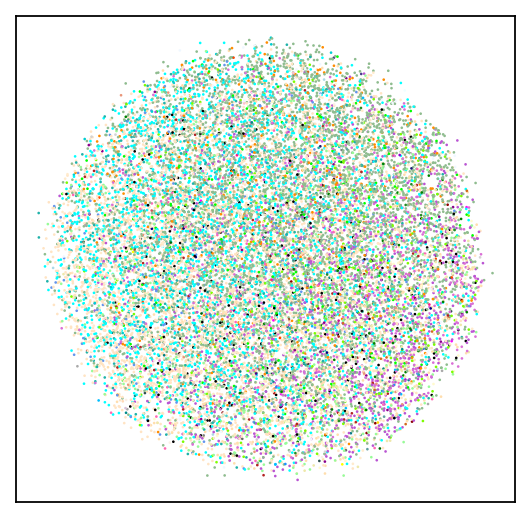

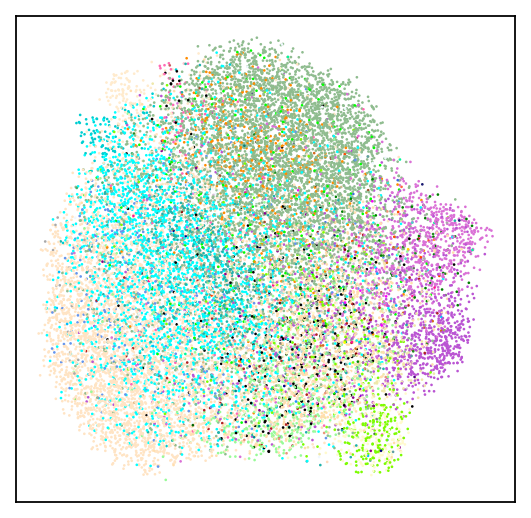

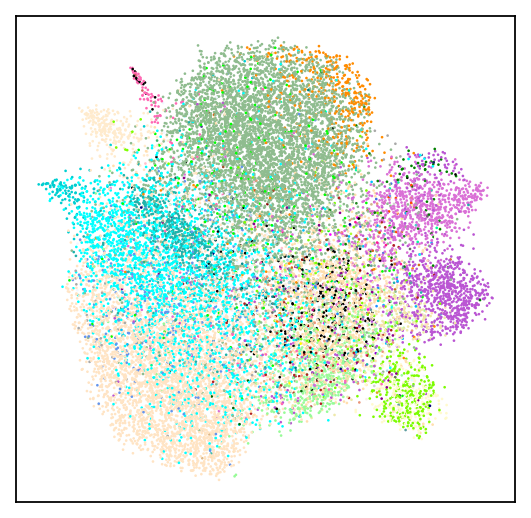

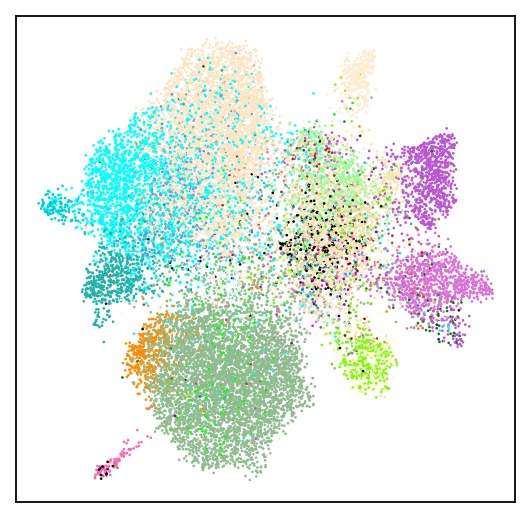

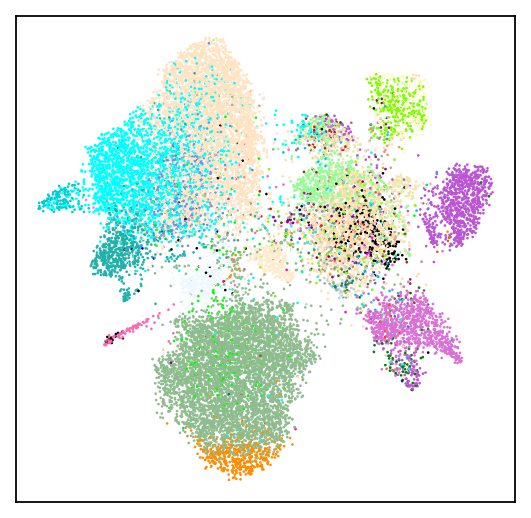

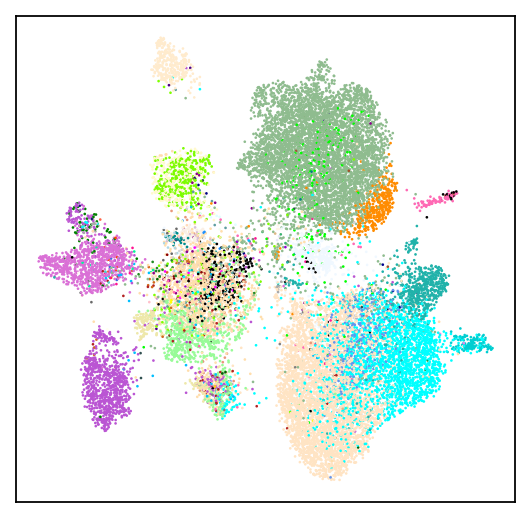

In [54]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        palette=list(matplotlib.colors.CSS4_COLORS.values()), #tons of colors for the tons of cats
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

0
300
600
700
800
900
1000


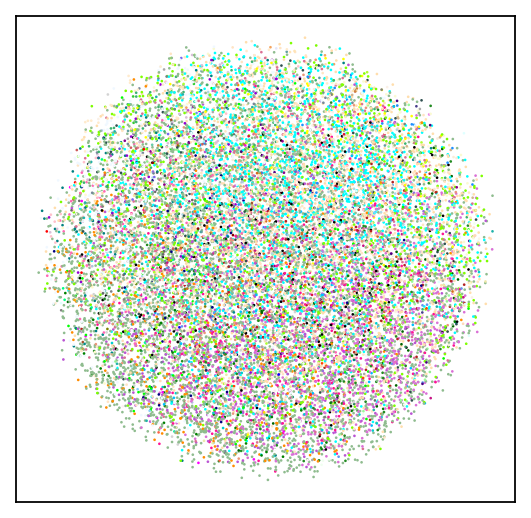

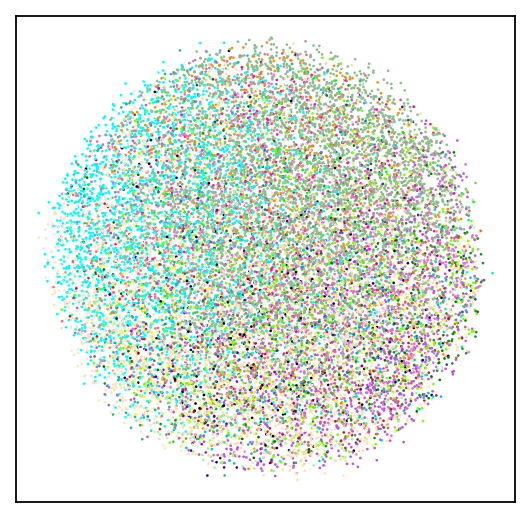

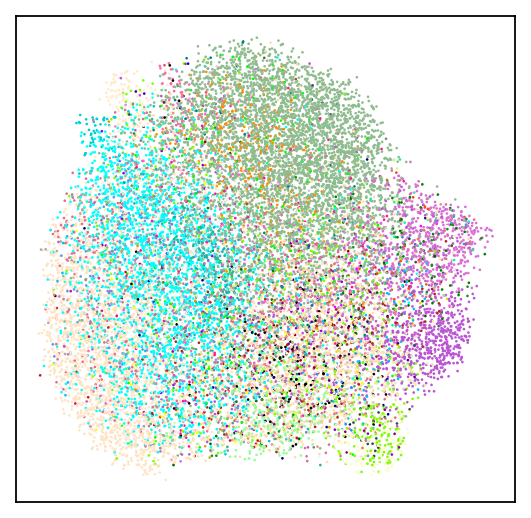

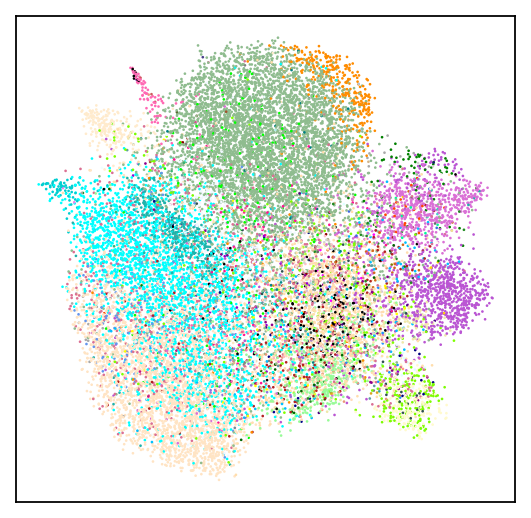

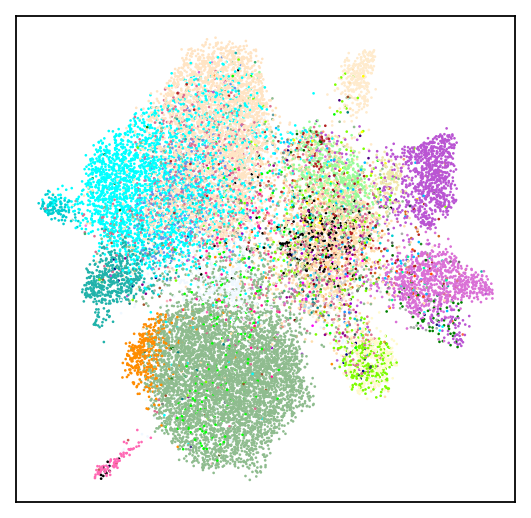

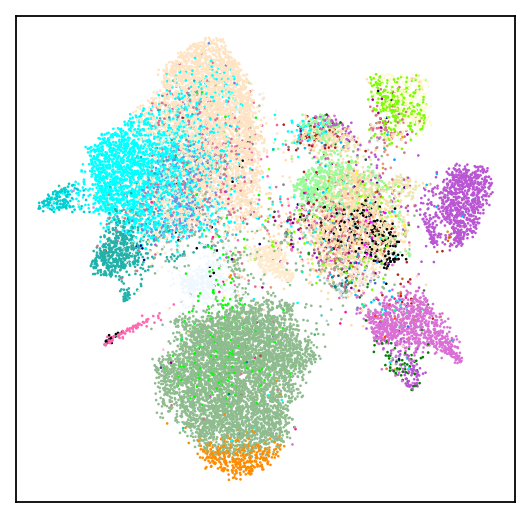

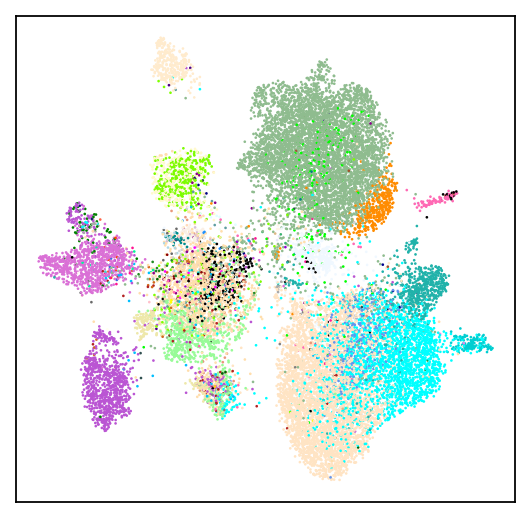

In [78]:
# rerun KNN at each timepoint

for timestep in [0,300,600,700,800,900,1000]:
    print(timestep)
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()

    # do KNN prediction at each timestep
    diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.obsm['x_T{}'.format(timestep)])
    diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')
    diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(true_adata.obs['cell_type_general'].astype("category").cat.categories)

    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        palette=list(matplotlib.colors.CSS4_COLORS.values()), #tons of colors for the tons of cats
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    #plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    #plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    #plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

#### quantify the proportion of each cell type in true and diffused tissues

In [158]:
tis_ct_props = pd.merge(pd.DataFrame(diffused_tis_adata.obs.predicted_cell_type_general.value_counts(normalize=True).sort_values(ascending=False)).reset_index().rename(
    columns={'predicted_cell_type_general':'cell_type', 'proportion':'synthetic proportions'}),
         pd.DataFrame(tis_adata.obs.cell_type_general.value_counts(normalize=True)).reset_index().rename(
    columns={'cell_type_general':'cell_type', 'proportion':'true proportions'}), 
         on="cell_type").set_index("cell_type")

In [159]:
tis_ct_props = tis_ct_props[tis_ct_props.sum(axis=1)!=0].sort_values('true proportions', ascending=False)
tis_ct_props

,synthetic proportions,true proportions
cell_type,,
macrophage,0.201715,0.201773
T cell,0.261124,0.187556
monocyte,0.119152,0.088269
type II pneumocyte,0.033254,0.071061
endothelial cell,0.043735,0.068700
...,...,...
neoplastic cell,0.000715,0.000000
IgA plasma cell,0.000715,0.000000
keratinocyte,0.000762,0.000000


In [160]:
print(tis_ct_props[:30].to_latex(index=True, escape=False))

\begin{tabular}{lrr}
\toprule
 & synthetic proportions & true proportions \\
cell_type &  &  \\
\midrule
macrophage & 0.201715 & 0.201773 \\
T cell & 0.261124 & 0.187556 \\
monocyte & 0.119152 & 0.088269 \\
type II pneumocyte & 0.033254 & 0.071061 \\
endothelial cell & 0.043735 & 0.068700 \\
fibroblast & 0.042020 & 0.045328 \\
natural killer cell & 0.019104 & 0.044489 \\
ciliated columnar cell of tracheobronchial tree & 0.014721 & 0.040659 \\
B cell & 0.020867 & 0.038324 \\
epithelial cell & 0.064459 & 0.033209 \\
dendritic cell & 0.029967 & 0.028383 \\
malignant cell & 0.013530 & 0.026704 \\
type I pneumocyte & 0.010624 & 0.023661 \\
neutrophil & 0.005860 & 0.022848 \\
plasma cell & 0.004288 & 0.021982 \\
mast cell & 0.014960 & 0.017470 \\
smooth muscle cell & 0.003954 & 0.005168 \\
pericyte & 0.002620 & 0.004827 \\
secretory cell & 0.003859 & 0.004695 \\
club cell & 0.001810 & 0.004197 \\
myeloid cell & 0.002573 & 0.004013 \\
nasal mucosa goblet cell & 0.001906 & 0.003830 \\
respirat

In [106]:
#pearson correlation
from scipy.stats import pearsonr
pearsonr(tis_ct_props[['synthetic proportions']], tis_ct_props[['true proportions']])

PearsonRResult(statistic=array([0.95153816]), pvalue=array([1.47272452e-54]))

### blood

In [77]:
tis = "blood"

In [78]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]

In [79]:
tis_adata.obs.cell_type.value_counts()[:15]

cell_type
naive thymus-derived CD4-positive, alpha-beta T cell    28255
central memory CD4-positive, alpha-beta T cell          26533
natural killer cell                                     18066
CD4-positive, alpha-beta T cell                         14507
classical monocyte                                      14477
effector memory CD8-positive, alpha-beta T cell         13107
CD14-positive monocyte                                  12682
CD8-positive, alpha-beta T cell                          9788
naive B cell                                             8984
naive thymus-derived CD8-positive, alpha-beta T cell     8918
CD16-positive, CD56-dim natural killer cell, human       8036
B cell                                                   6442
effector memory CD4-positive, alpha-beta T cell          3714
memory B cell                                            3634
gamma-delta T cell                                       3489
Name: count, dtype: int64

In [80]:
tis_adata.obs.patient_id.nunique()

224

In [81]:
# fraction naive cells in patient sample
tis_adata.obs['naive'] = [1 if 'naive' in i else 0 for i in tis_adata.obs.cell_type]
tis_adata.obs['frac_naive'] = tis_adata.obs.groupby('patient_id')['naive'].transform('mean')
tis_adata.obs[['patient_id','frac_naive']].drop_duplicates().frac_naive.sort_values(ascending=False)[:30]

/tmp/ipykernel_2789091/3150641247.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  tis_adata.obs['naive'] = [1 if 'naive' in i else 0 for i in tis_adata.obs.cell_type]
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


16    0.743056
16    0.722222
16    0.699301
16    0.698413
16    0.591270
16    0.588294
16    0.560166
16    0.522817
16    0.515873
16    0.509921
16    0.482143
16    0.480692
16    0.453674
16    0.444444
16    0.443452
16    0.434524
16    0.423611
16    0.422619
16    0.413690
16    0.405754
16    0.403808
16    0.399802
16    0.394432
16    0.389881
16    0.388889
16    0.387897
16    0.384921
16    0.374008
16    0.372024
16    0.370040
Name: frac_naive, dtype: float64

(array([56.,  4., 11., 16., 15., 12., 17., 16., 27., 21., 10.,  6.,  3.,
         2.,  1.,  3.,  0.,  0.,  2.,  2.]),
 array([0.        , 0.03715278, 0.07430556, 0.11145833, 0.14861111,
        0.18576389, 0.22291667, 0.26006944, 0.29722222, 0.334375  ,
        0.37152778, 0.40868056, 0.44583333, 0.48298611, 0.52013889,
        0.55729167, 0.59444444, 0.63159722, 0.66875   , 0.70590278,
        0.74305556]),
 <BarContainer object of 20 artists>)

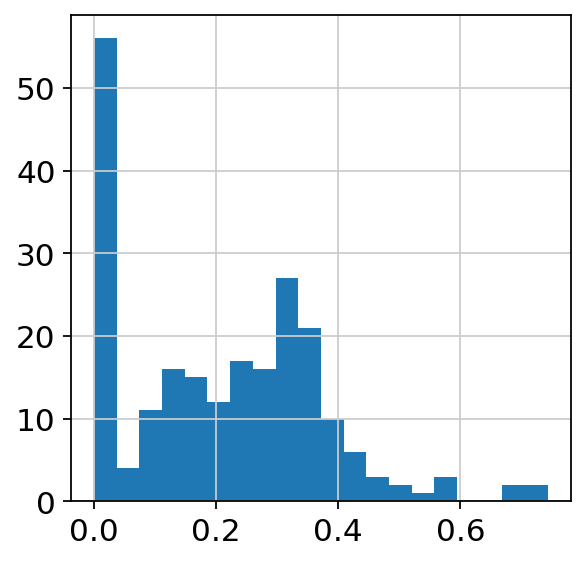

In [72]:
plt.hist(tis_adata.obs[['patient_id','frac_naive']].drop_duplicates().frac_naive, bins=20)

In [73]:
# remove samples with a lot of "naive" cells
tis_adata = tis_adata[tis_adata.obs.frac_naive<0.5]

In [82]:
sc.pp.neighbors(tis_adata, use_rep="scvi")


In [83]:

sc.tl.umap(tis_adata)

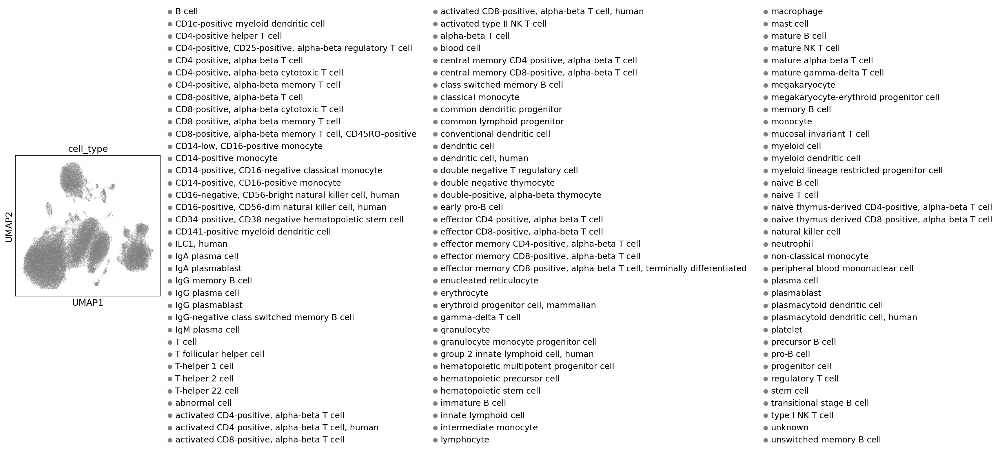

In [84]:
sc.pl.umap(tis_adata, color="cell_type")

In [91]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [92]:
tis_adata.obs.cell_type_general.value_counts()[:15]

cell_type_general
T cell                      90712
naive T cell                37518
monocyte                    34870
natural killer cell         27265
B cell                      14428
naive B cell                 8984
dendritic cell               2616
platelet                     1508
plasmablast                   835
T-helper                      730
blood cell                    726
T follicular helper cell      663
unknown                       326
progenitor cell               324
erythrocyte                   237
Name: count, dtype: int64

In [93]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


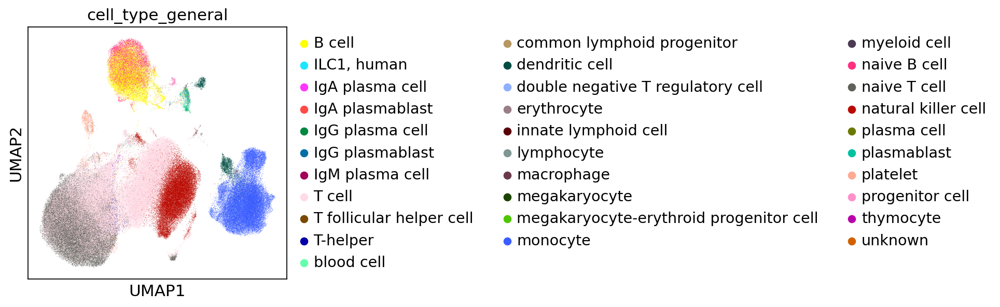

In [94]:
sc.pl.umap(tis_adata, color="cell_type_general")

In [95]:
tis_adata.obs.cell_type_general.value_counts()[:15]

cell_type_general
T cell                      90712
naive T cell                37518
monocyte                    34870
natural killer cell         27265
B cell                      14428
naive B cell                 8984
dendritic cell               2616
platelet                     1508
plasmablast                   835
T-helper                      730
blood cell                    726
T follicular helper cell      663
unknown                       326
progenitor cell               324
erythrocyte                   237
Name: count, dtype: int64

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


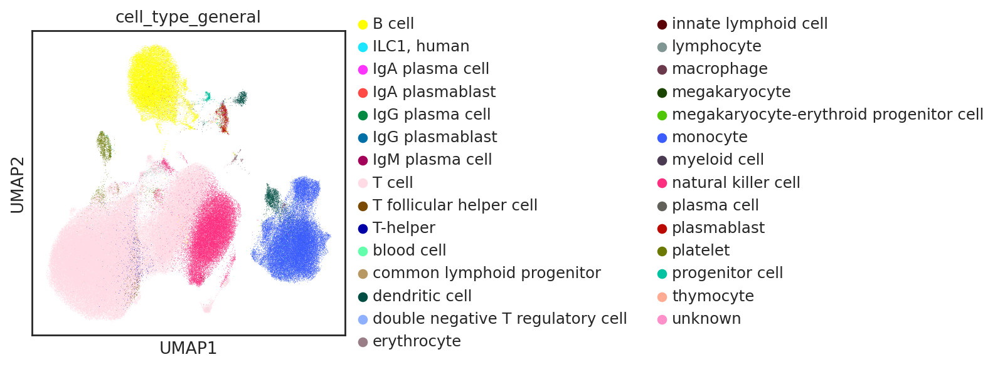

In [136]:
sc.pl.umap(tis_adata, color="cell_type_general")

#### set up diffused lung adata with annots + assign cell types using KNN

In [96]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [97]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [98]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [99]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [100]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]

#### make sure legend colors are the same for true and diffused umaps

In [101]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2789091/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

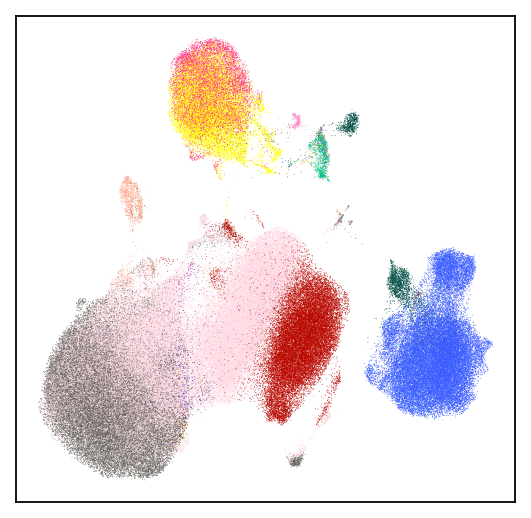

In [104]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these samples

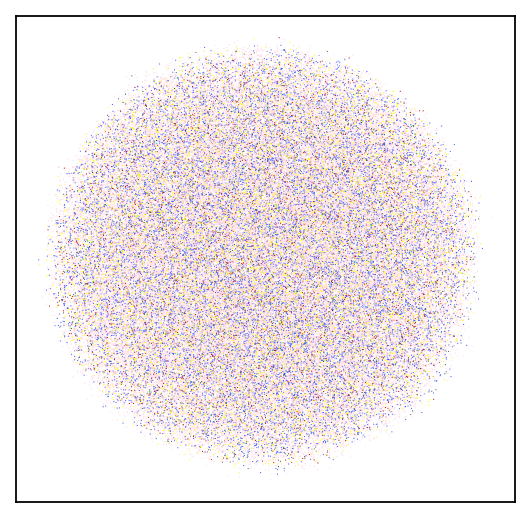

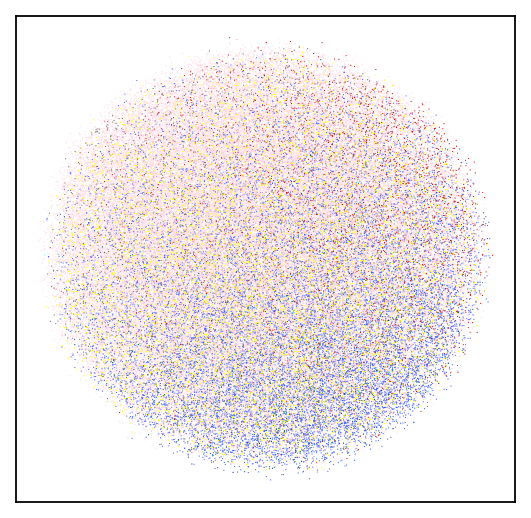

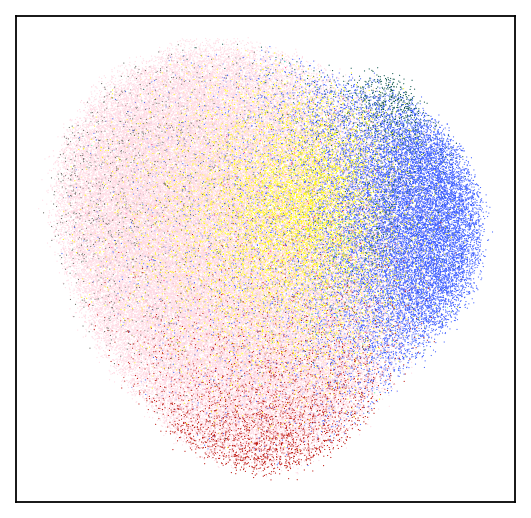

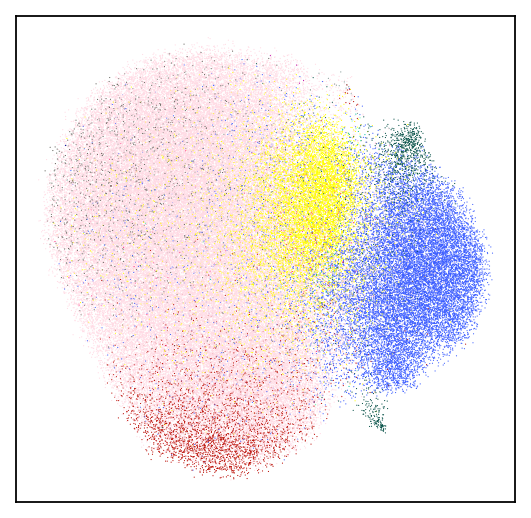

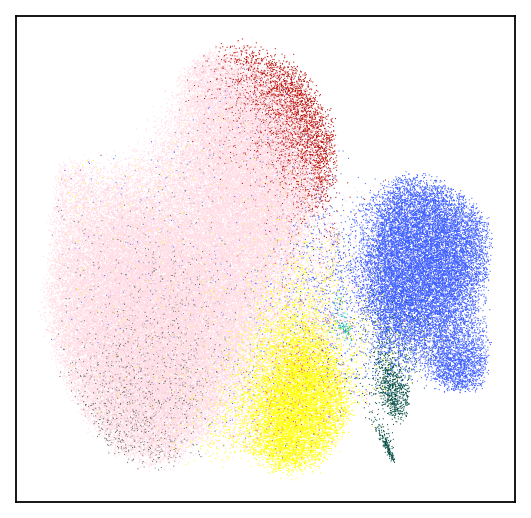

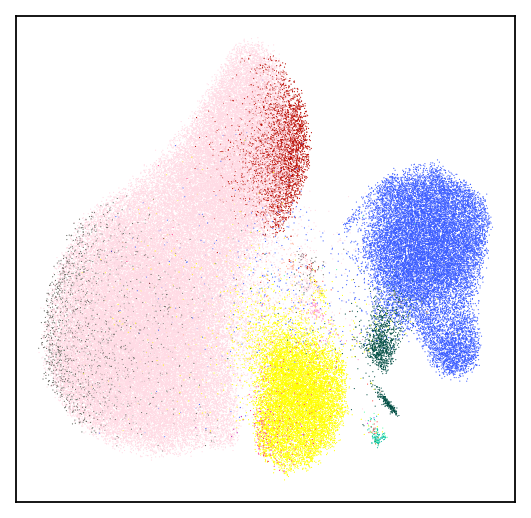

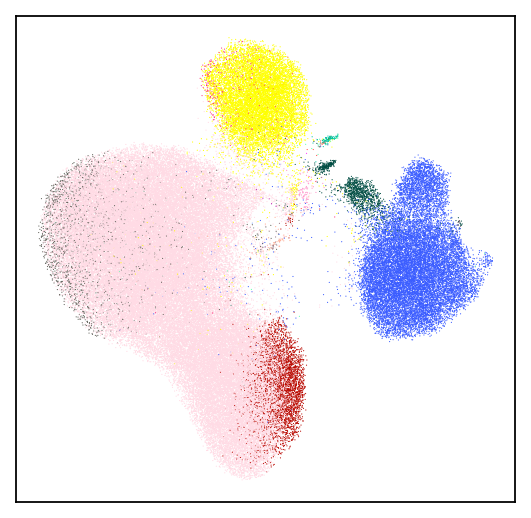

In [105]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

#### quantify the proportion of each cell type in true and diffused tissues

In [107]:
tis_ct_props = pd.merge(pd.DataFrame(diffused_tis_adata.obs.predicted_cell_type_general.value_counts(normalize=True).sort_values(ascending=False)).reset_index().rename(
    columns={'predicted_cell_type_general':'cell_type', 'proportion':'synthetic proportions'}),
         pd.DataFrame(tis_adata.obs.cell_type_general.value_counts(normalize=True)).reset_index().rename(
    columns={'cell_type_general':'cell_type', 'proportion':'true proportions'}), 
         on="cell_type").set_index("cell_type")

In [108]:
tis_ct_props = tis_ct_props[tis_ct_props.sum(axis=1)!=0].sort_values('true proportions', ascending=False)
tis_ct_props

,synthetic proportions,true proportions
cell_type,,
T cell,0.671453,0.407475
naive T cell,0.017003,0.168529
monocyte,0.161800,0.156635
natural killer cell,0.030631,0.122473
B cell,0.101011,0.064810
naive B cell,0.003179,0.040356
dendritic cell,0.011306,0.011751
platelet,0.000768,0.006774
plasmablast,0.000804,0.003751


In [109]:
tis_ct_props[:30]

,synthetic proportions,true proportions
cell_type,,
T cell,0.671453,0.407475
naive T cell,0.017003,0.168529
monocyte,0.161800,0.156635
natural killer cell,0.030631,0.122473
B cell,0.101011,0.064810
naive B cell,0.003179,0.040356
dendritic cell,0.011306,0.011751
platelet,0.000768,0.006774
plasmablast,0.000804,0.003751


In [111]:
print(tis_ct_props[:30].to_latex(index=True, escape=False))

\begin{tabular}{lrr}
\toprule
 & synthetic proportions & true proportions \\
cell_type &  &  \\
\midrule
T cell & 0.671453 & 0.407475 \\
naive T cell & 0.017003 & 0.168529 \\
monocyte & 0.161800 & 0.156635 \\
natural killer cell & 0.030631 & 0.122473 \\
B cell & 0.101011 & 0.064810 \\
naive B cell & 0.003179 & 0.040356 \\
dendritic cell & 0.011306 & 0.011751 \\
platelet & 0.000768 & 0.006774 \\
plasmablast & 0.000804 & 0.003751 \\
T-helper & 0.000009 & 0.003279 \\
blood cell & 0.000357 & 0.003261 \\
T follicular helper cell & 0.000071 & 0.002978 \\
progenitor cell & 0.000911 & 0.001455 \\
erythrocyte & 0.000170 & 0.001065 \\
lymphocyte & 0.000143 & 0.001038 \\
thymocyte & 0.000054 & 0.000916 \\
plasma cell & 0.000036 & 0.000687 \\
IgG plasma cell & 0.000009 & 0.000445 \\
IgA plasma cell & 0.000009 & 0.000427 \\
double negative T regulatory cell & 0.000009 & 0.000337 \\
innate lymphoid cell & 0.000036 & 0.000296 \\
macrophage & 0.000054 & 0.000225 \\
IgA plasmablast & 0.000161 & 0.00018

In [110]:
#pearson correlation
from scipy.stats import pearsonr
pearsonr(tis_ct_props[['synthetic proportions']], tis_ct_props[['true proportions']])

PearsonRResult(statistic=array([0.90964367]), pvalue=array([3.38371828e-12]))

### heart

In [112]:
tis = "heart"

In [113]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


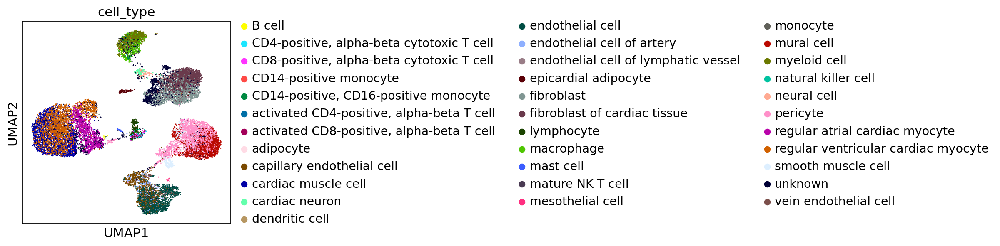

In [114]:
sc.pl.umap(tis_adata, color="cell_type")

In [115]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [116]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

#### set up diffused lung adata with annots + assign cell types using KNN

In [117]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [118]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [119]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [120]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [121]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure legend colors are the same for true and diffused umaps

In [122]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2789091/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


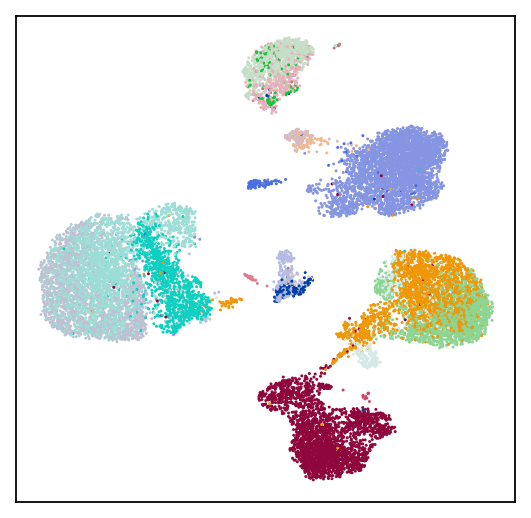

In [123]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these lung samples

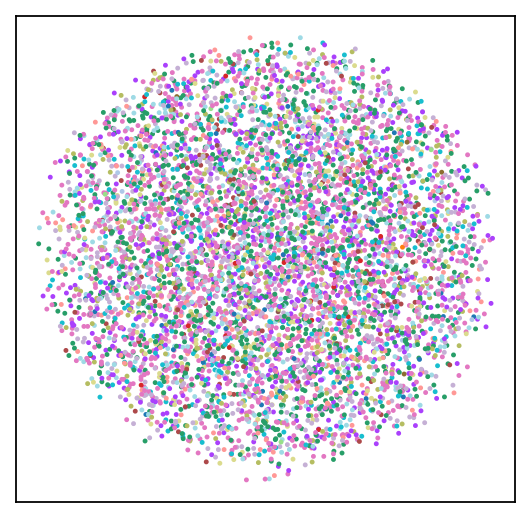

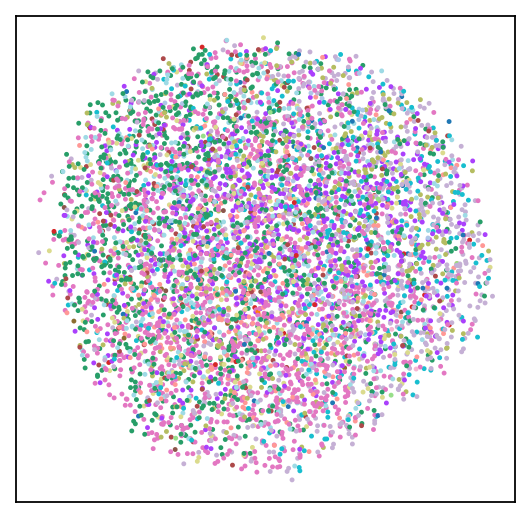

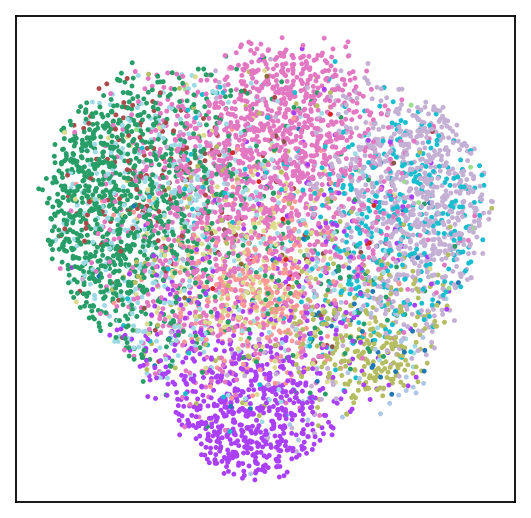

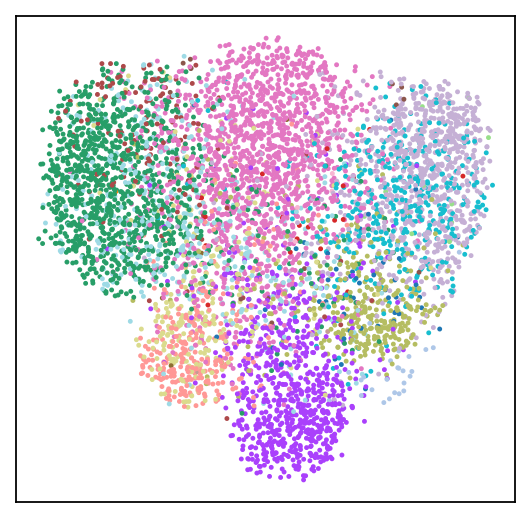

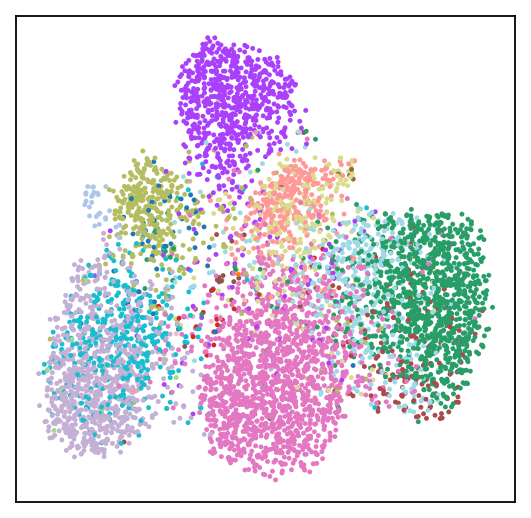

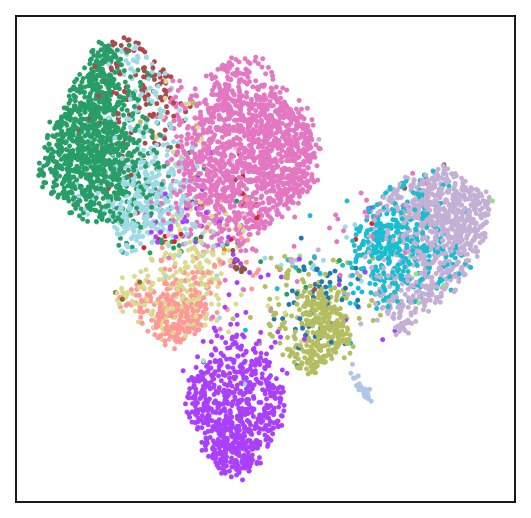

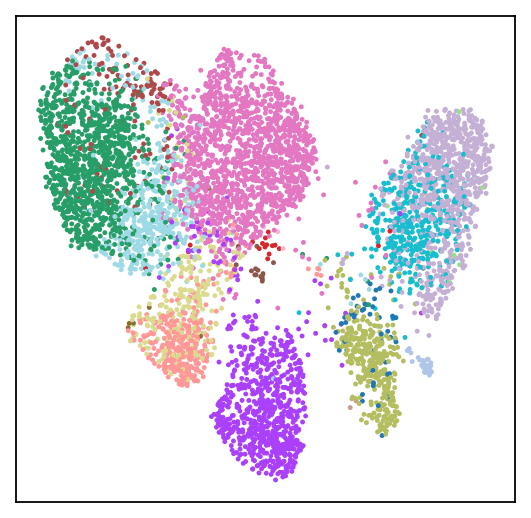

In [493]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

#### quantify the proportion of each cell type in true and diffused tissues

In [124]:
tis_ct_props = pd.merge(pd.DataFrame(diffused_tis_adata.obs.predicted_cell_type_general.value_counts(normalize=True).sort_values(ascending=False)).reset_index().rename(
    columns={'predicted_cell_type_general':'cell_type', 'proportion':'synthetic proportions'}),
         pd.DataFrame(tis_adata.obs.cell_type_general.value_counts(normalize=True)).reset_index().rename(
    columns={'cell_type_general':'cell_type', 'proportion':'true proportions'}), 
         on="cell_type").set_index("cell_type")

In [125]:
tis_ct_props = tis_ct_props[tis_ct_props.sum(axis=1)!=0].sort_values('true proportions', ascending=False)

In [128]:
print(tis_ct_props[:30].to_latex(index=True, escape=False))

\begin{tabular}{lrr}
\toprule
 & synthetic proportions & true proportions \\
cell_type &  &  \\
\midrule
fibroblast & 0.232488 & 0.193614 \\
endothelial cell & 0.117873 & 0.151561 \\
regular ventricular cardiac myocyte & 0.144636 & 0.133050 \\
pericyte & 0.066325 & 0.113281 \\
cardiac muscle cell & 0.086572 & 0.110705 \\
mural cell & 0.033279 & 0.098604 \\
regular atrial cardiac myocyte & 0.082965 & 0.066016 \\
myeloid cell & 0.085408 & 0.046247 \\
macrophage & 0.072609 & 0.020128 \\
smooth muscle cell & 0.001280 & 0.018211 \\
lymphocyte & 0.041541 & 0.015755 \\
T cell & 0.023272 & 0.006110 \\
cardiac neuron & 0.001629 & 0.005931 \\
epicardial adipocyte & 0.002444 & 0.005871 \\
monocyte & 0.001513 & 0.005152 \\
neural cell & 0.001164 & 0.005092 \\
mast cell & 0.003258 & 0.001677 \\
natural killer cell & 0.000000 & 0.000839 \\
dendritic cell & 0.001745 & 0.000779 \\
adipocyte & 0.000000 & 0.000719 \\
mesothelial cell & 0.000000 & 0.000659 \\
\bottomrule
\end{tabular}



In [127]:
#pearson correlation
from scipy.stats import pearsonr
pearsonr(tis_ct_props[['synthetic proportions']], tis_ct_props[['true proportions']])

PearsonRResult(statistic=array([0.89466855]), pvalue=array([4.47745544e-08]))

### breast

In [129]:
tis = "breast"

In [130]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


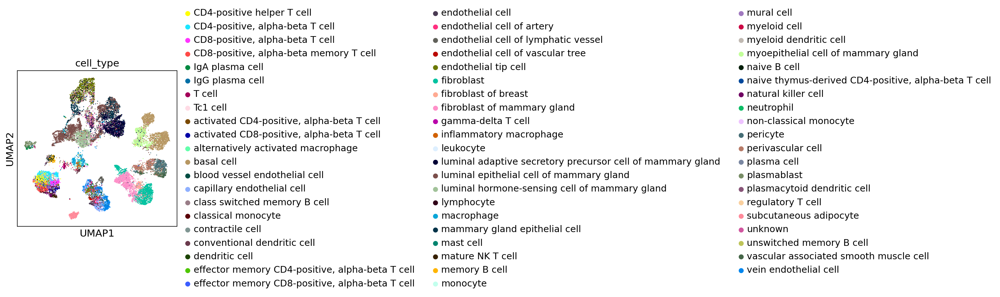

In [131]:
sc.pl.umap(tis_adata, color="cell_type")

In [132]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [133]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

#### set up diffused tis adata with annots + assign cell types using KNN

In [134]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [135]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [136]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [137]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [138]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure legend colors are the same for true and diffused umaps

In [139]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2789091/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


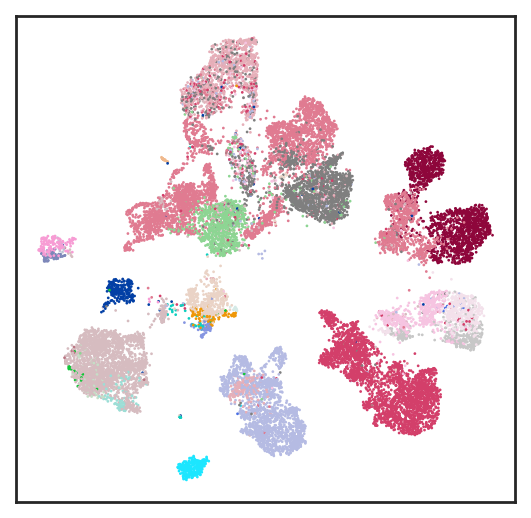

In [156]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these samples

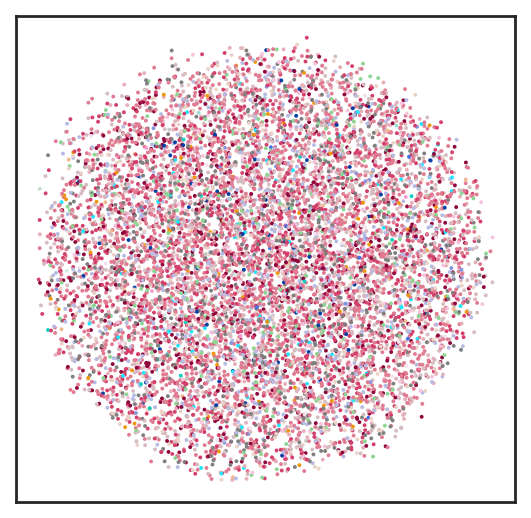

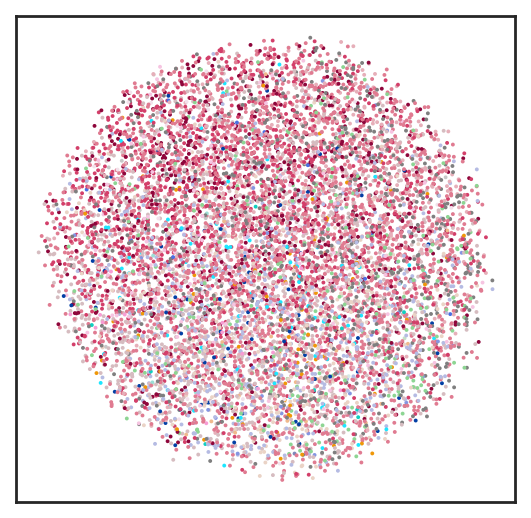

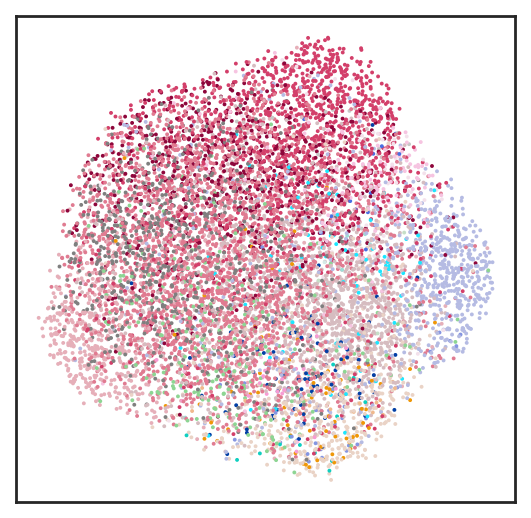

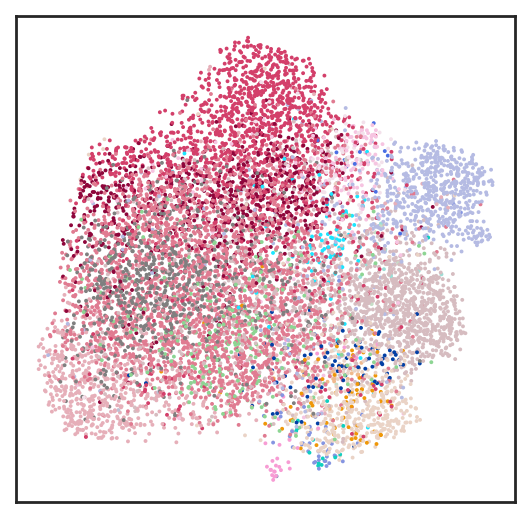

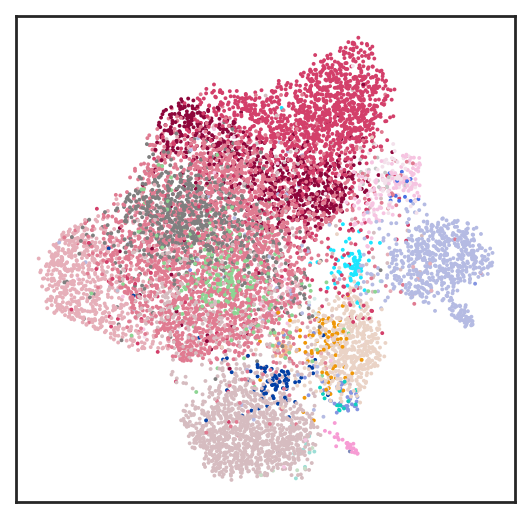

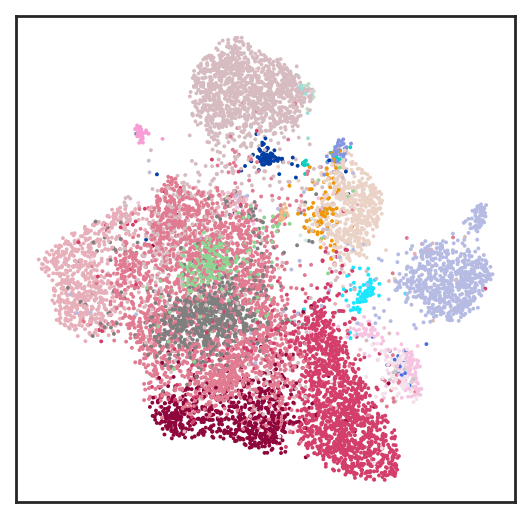

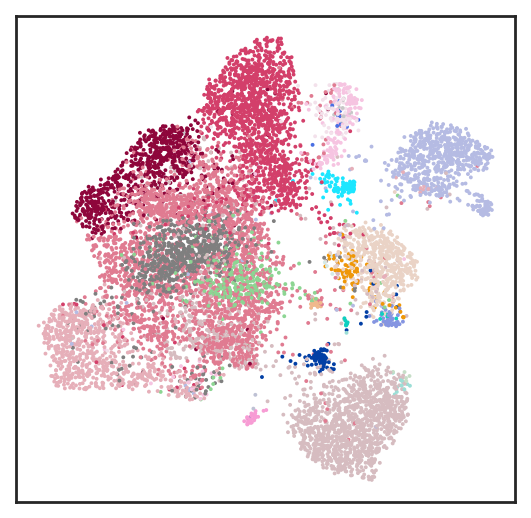

In [157]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

#### quantify the proportion of each cell type in true and diffused tissues

In [141]:
tis_ct_props = pd.merge(pd.DataFrame(diffused_tis_adata.obs.predicted_cell_type_general.value_counts(normalize=True).sort_values(ascending=False)).reset_index().rename(
    columns={'predicted_cell_type_general':'cell_type', 'proportion':'synthetic proportions'}),
         pd.DataFrame(tis_adata.obs.cell_type_general.value_counts(normalize=True)).reset_index().rename(
    columns={'cell_type_general':'cell_type', 'proportion':'true proportions'}), 
         on="cell_type").set_index("cell_type")

In [142]:
tis_ct_props = tis_ct_props[tis_ct_props.sum(axis=1)!=0].sort_values('true proportions', ascending=False)

In [143]:
print(tis_ct_props[:30].to_latex(index=True, escape=False))

\begin{tabular}{lrr}
\toprule
 & synthetic proportions & true proportions \\
cell_type &  &  \\
\midrule
epithelial cell & 0.270300 & 0.204534 \\
fibroblast & 0.139667 & 0.146364 \\
T cell & 0.158140 & 0.115783 \\
endothelial cell & 0.073285 & 0.092961 \\
progenitor cell & 0.079273 & 0.089614 \\
basal cell & 0.070646 & 0.079420 \\
endothelial tip cell & 0.070443 & 0.060402 \\
luminal hormone-sensing cell of mammary gland & 0.024259 & 0.046506 \\
perivascular cell & 0.017052 & 0.036515 \\
pericyte & 0.009541 & 0.022112 \\
macrophage & 0.046488 & 0.021452 \\
smooth muscle cell & 0.002436 & 0.018359 \\
subcutaneous adipocyte & 0.007917 & 0.014657 \\
B cell & 0.006293 & 0.008317 \\
plasmablast & 0.001827 & 0.007151 \\
naive B cell & 0.000812 & 0.005376 \\
natural killer cell & 0.001827 & 0.004970 \\
monocyte & 0.007714 & 0.004564 \\
IgA plasma cell & 0.000812 & 0.004311 \\
dendritic cell & 0.006192 & 0.003398 \\
naive T cell & 0.000000 & 0.002891 \\
lymphocyte & 0.000000 & 0.002434 \\
myel

In [144]:
#pearson correlation
from scipy.stats import pearsonr
pearsonr(tis_ct_props[['synthetic proportions']], tis_ct_props[['true proportions']])

PearsonRResult(statistic=array([0.9681019]), pvalue=array([9.24241506e-18]))

### kidney

In [158]:
tis = "kidney"

In [159]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [160]:
print("Analyzing {} test samples from {}".format(tis_adata.obs.patient_id.nunique(), tis))

Analyzing 25 test samples from kidney


In [161]:
os.makedirs("figures/umap/diffused_{}_cells_umaps/umaps_notext".format(tis), exist_ok=True)


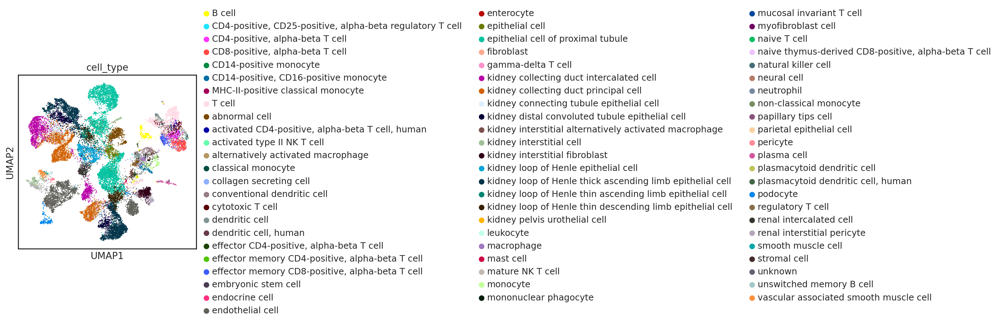

In [162]:
sc.pl.umap(tis_adata, color="cell_type")

In [163]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [164]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

#### set up diffused tis adata with annots + assign cell types using KNN

In [165]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [166]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [167]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [168]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [169]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure legend colors are the same for true and diffused umaps

In [170]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2379955/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


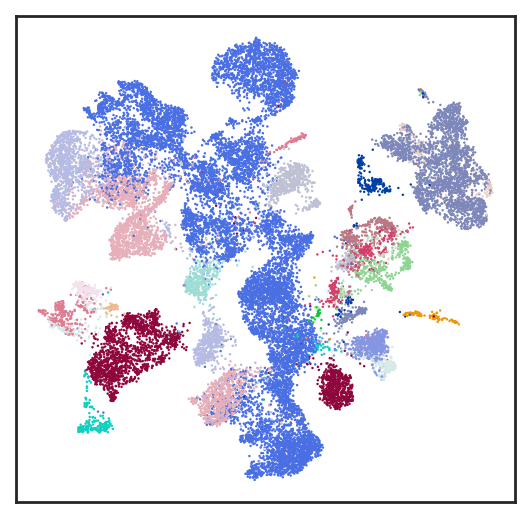

In [171]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these samples

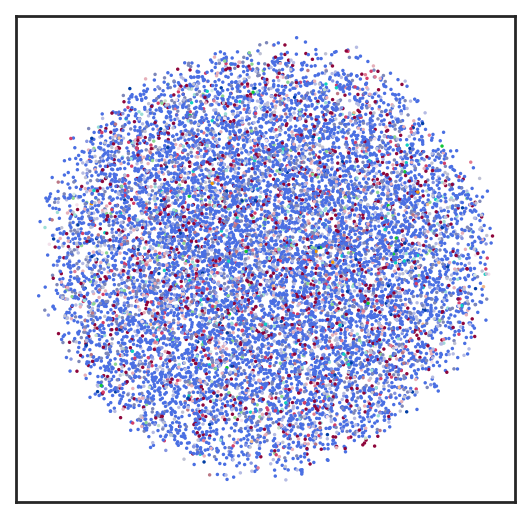

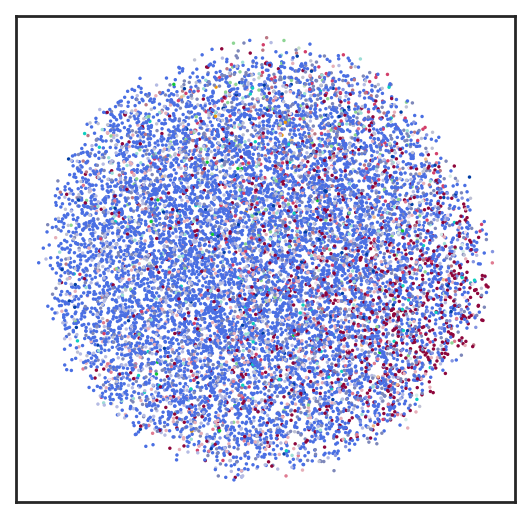

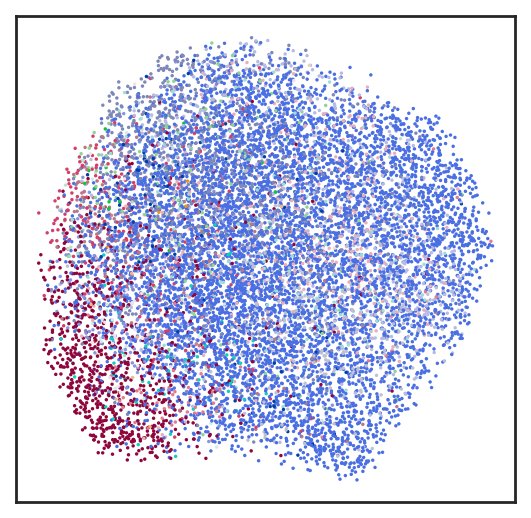

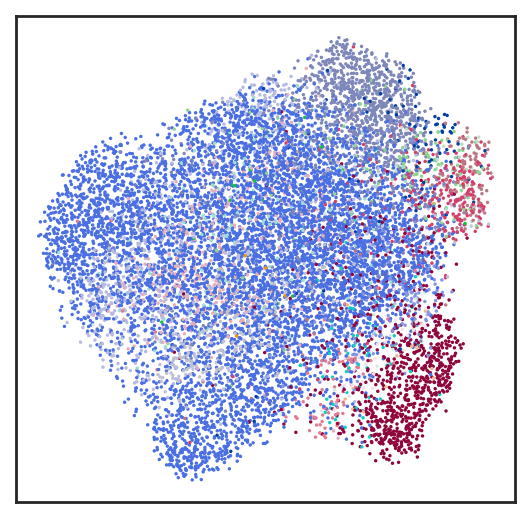

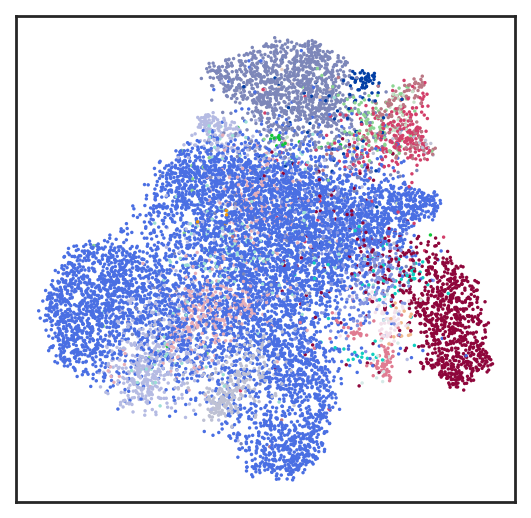

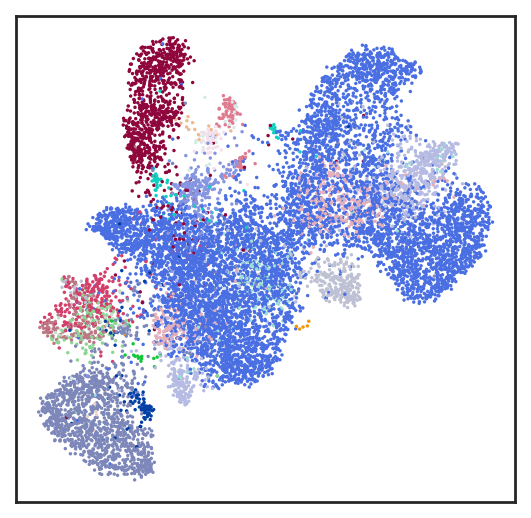

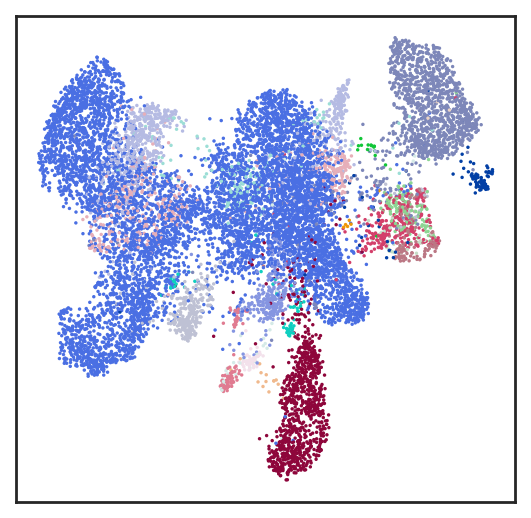

In [172]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

### brain

In [73]:
tis = "brain"

In [75]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [76]:
print("Analyzing {} test samples from {}".format(tis_adata.obs.patient_id.nunique(), tis))

Analyzing 44 test samples from brain


In [77]:
os.makedirs("figures/umap/diffused_{}_cells_umaps/umaps_notext".format(tis), exist_ok=True)


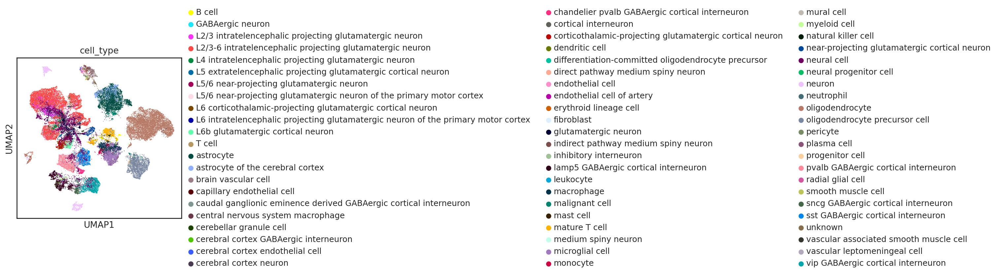

In [78]:
sc.pl.umap(tis_adata, color="cell_type")

In [79]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [80]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

#### set up diffused tis adata with annots + assign cell types using KNN

In [81]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [82]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [83]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [84]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [85]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure legend colors are the same for true and diffused umaps

In [86]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2379955/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


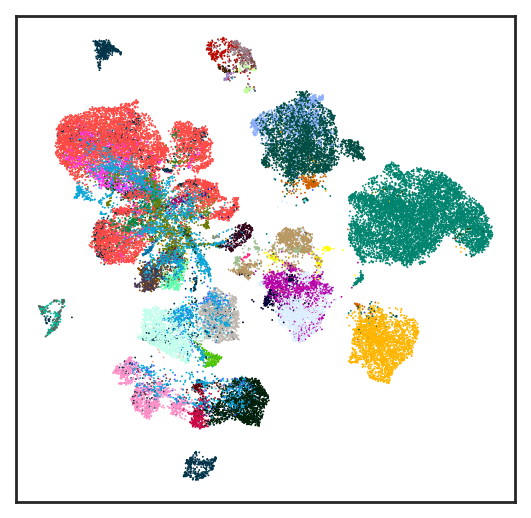

In [87]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these samples

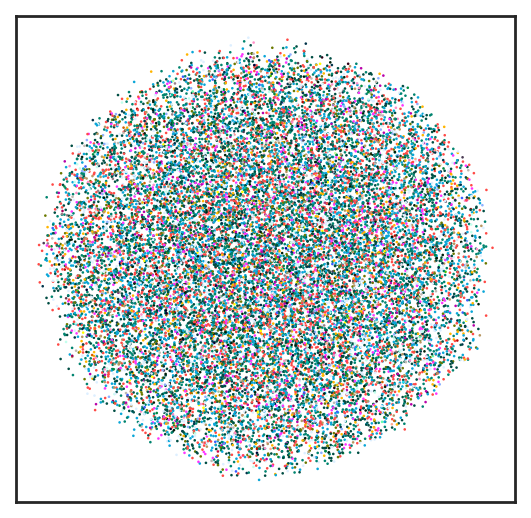

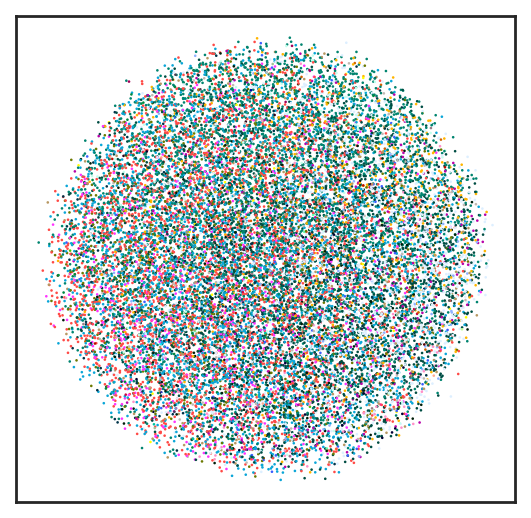

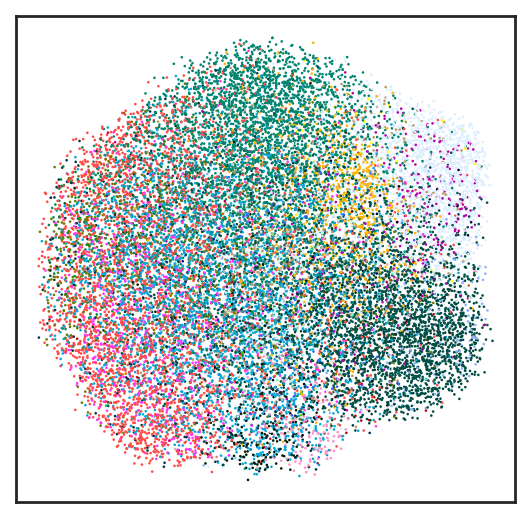

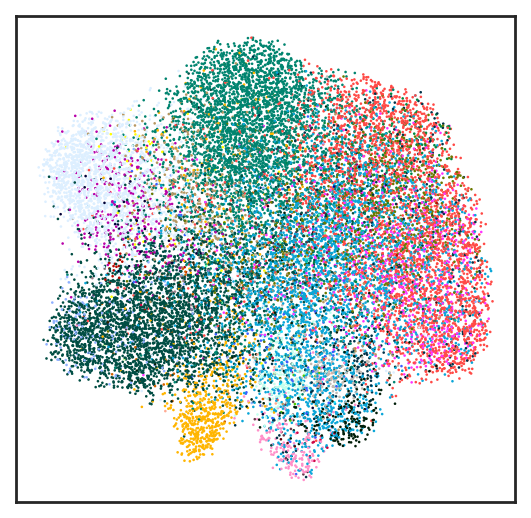

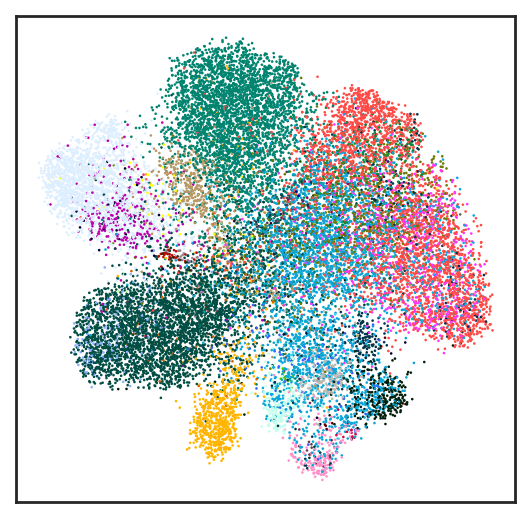

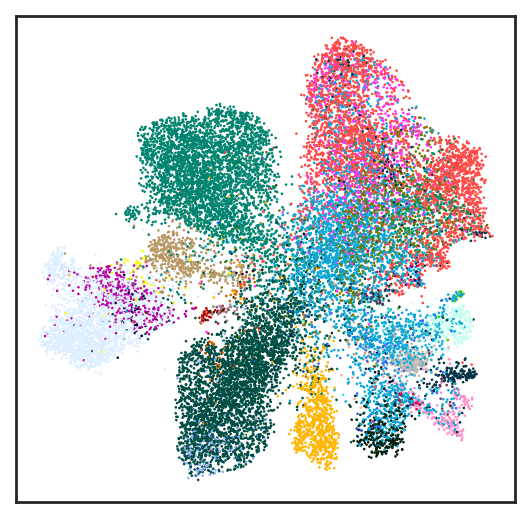

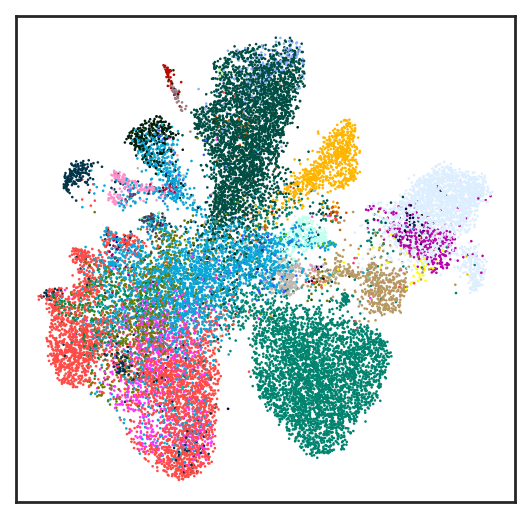

In [88]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

### eye

In [99]:
tis = "eye"

In [100]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [101]:
print("Analyzing {} test samples from {}".format(tis_adata.obs.patient_id.nunique(), tis))

Analyzing 10 test samples from eye


In [102]:
os.makedirs("figures/umap/diffused_{}_cells_umaps/umaps_notext".format(tis), exist_ok=True)


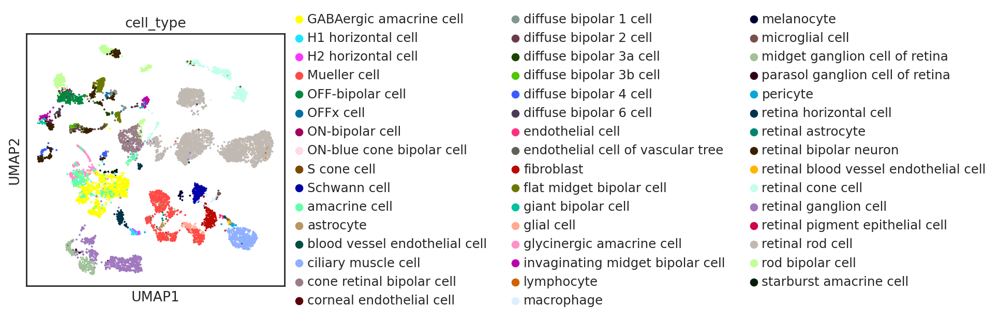

In [103]:
sc.pl.umap(tis_adata, color="cell_type")

In [104]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [105]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

#### set up diffused tis adata with annots + assign cell types using KNN

In [106]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [107]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [108]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [109]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [110]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure legend colors are the same for true and diffused umaps

In [111]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2379955/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


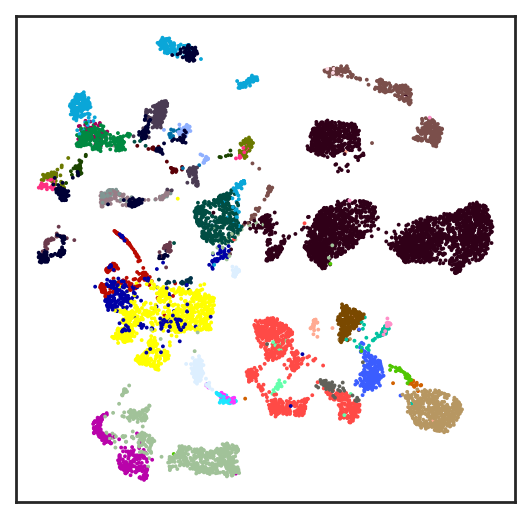

In [112]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these samples

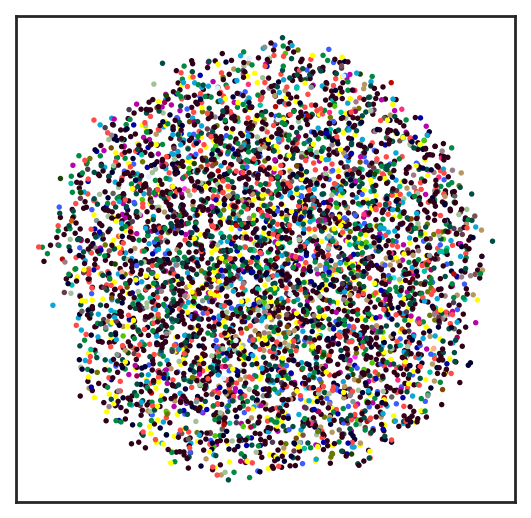

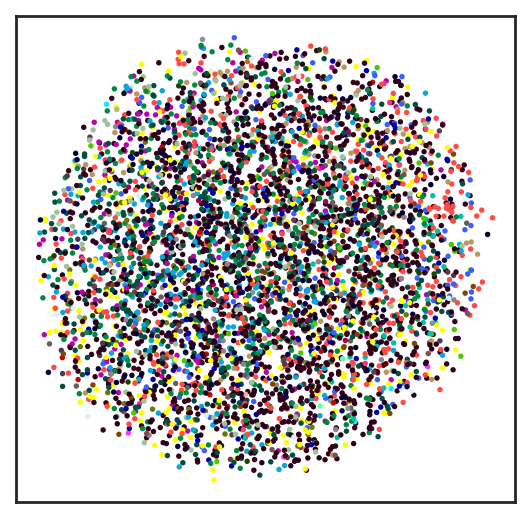

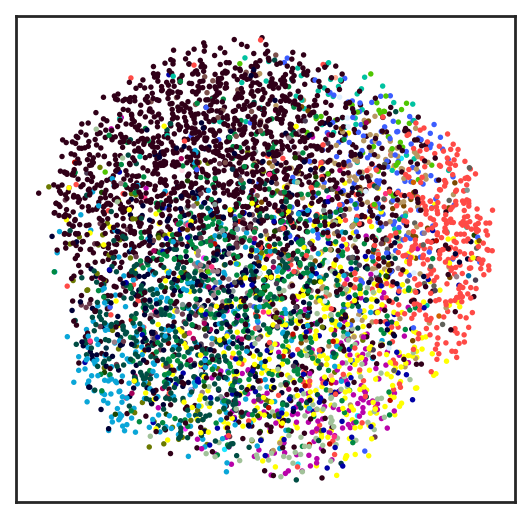

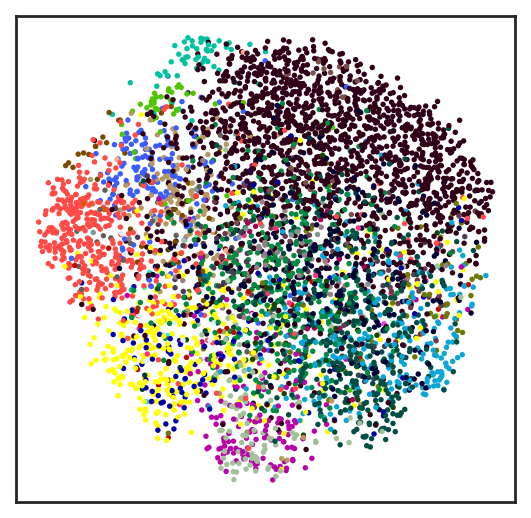

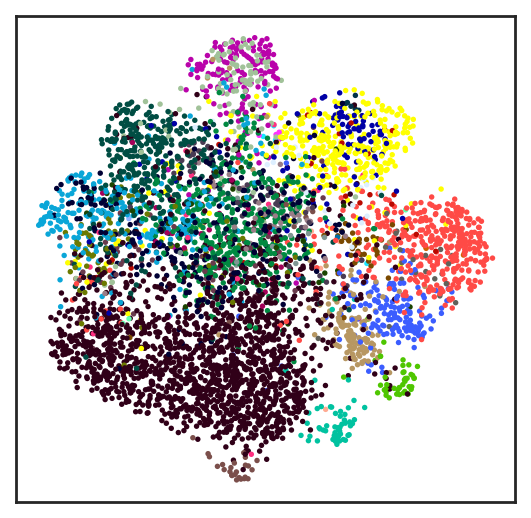

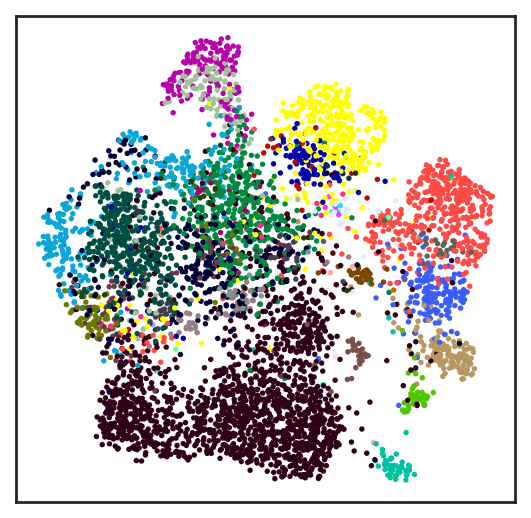

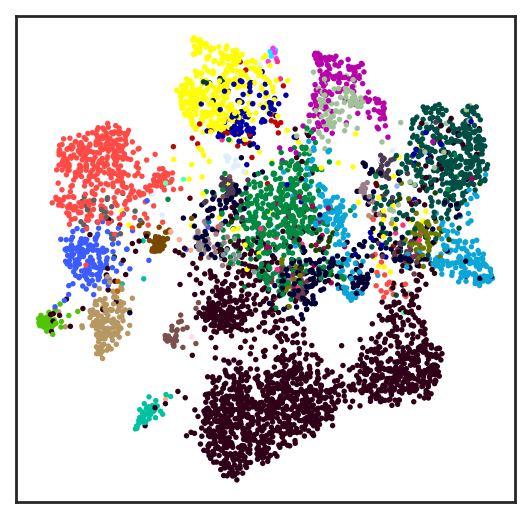

In [113]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

### small intestine

In [117]:
tis = "small intestine"

In [124]:
tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
sc.pp.neighbors(tis_adata, use_rep="scvi")
sc.tl.umap(tis_adata)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [119]:
print("Analyzing {} test samples from {}".format(tis_adata.obs.patient_id.nunique(), tis))

Analyzing 13 test samples from small intestine


In [120]:
os.makedirs("figures/umap/diffused_{}_cells_umaps/umaps_notext".format(tis), exist_ok=True)


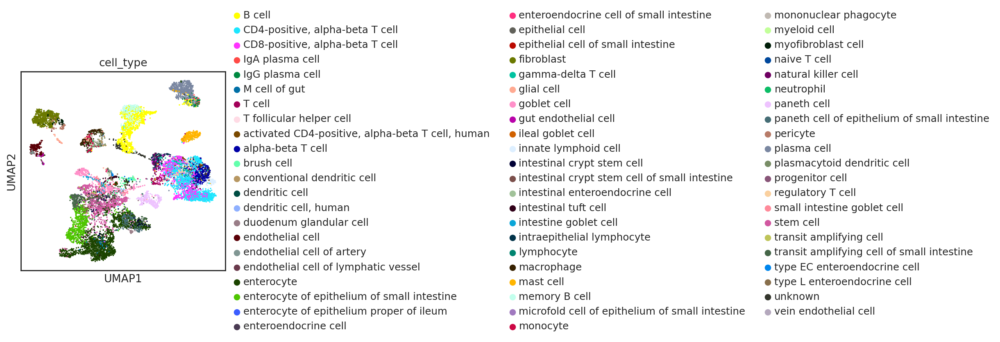

In [121]:
sc.pl.umap(tis_adata, color="cell_type")

In [122]:
# create coarser cell type col
tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())

In [123]:
# remove cell types with less than 10 counts, won't add to visualization
ct_to_keep = list(tis_adata.obs.cell_type_general.value_counts().index[tis_adata.obs.cell_type_general.value_counts()>10])
tis_adata = tis_adata[tis_adata.obs.cell_type_general.isin(ct_to_keep)]

#### set up diffused tis adata with annots + assign cell types using KNN

In [106]:
diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]

In [107]:
# create adata for diffused cells. .X holds cells at final timepoint
diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [108]:
## assign cell types to generated cells by using a KNN classifier, to use for viz

from sklearn.neighbors import KNeighborsClassifier  

neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')

#### remove 'unknown' cells from true and diffuse, so they don't mar visualization (possibly important to do this before the first sc.pl.umap call so that not included in color mapping)

In [109]:
tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]

In [110]:
bool_diffcells_nounknown = diffused_tis_adata.obs['predicted_cell_type_general']!="unknown"
diffused_tis_adata = diffused_tis_adata[bool_diffcells_nounknown]

#update diffused_tis_idx so that subset intermediate steps correctly
diffused_tis_idx = diffused_tis_idx[bool_diffcells_nounknown]



#### make sure legend colors are the same for true and diffused umaps

In [111]:
diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)

/tmp/ipykernel_2379955/940174487.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype("category").cat.set_categories(tis_adata.obs['cell_type_general'].astype("category").cat.categories)


#### viz true data

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


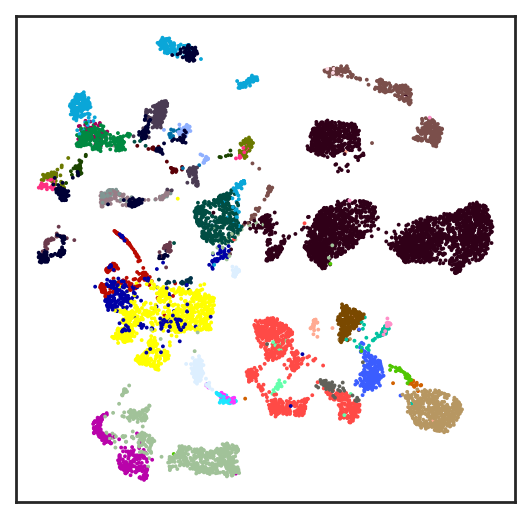

In [112]:
# save umap of true data

fig = sc.pl.umap(tis_adata, color="cell_type_general", return_fig=True)
ax = fig.axes[0]
ax.legend_.set_bbox_to_anchor((1.1,0.5))
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")
plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_truecells.png".format(tis, tis), dpi=300, bbox_inches="tight")

#create version with no text for easier use in illustrator
ax.legend_.remove()
ax.set_title("");
ax.set_xlabel("");
ax.set_ylabel("");
plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_truecells.pdf".format(tis, tis), dpi=300, bbox_inches="tight")

#### now visualize intermediate steps for these samples

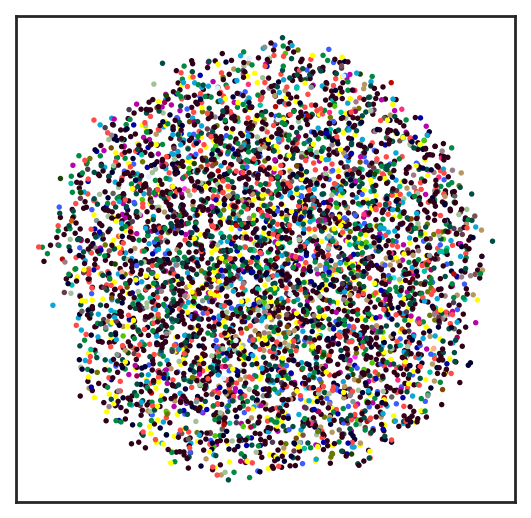

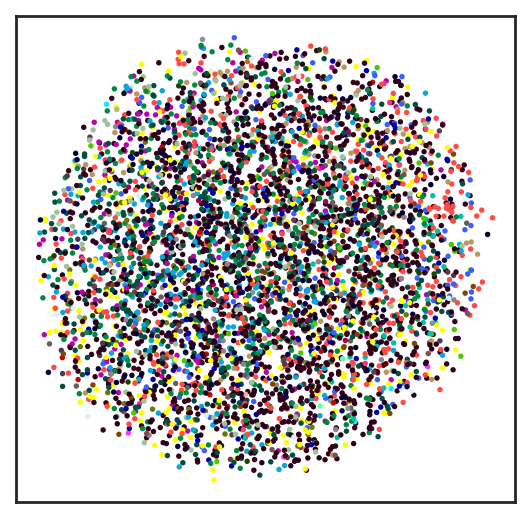

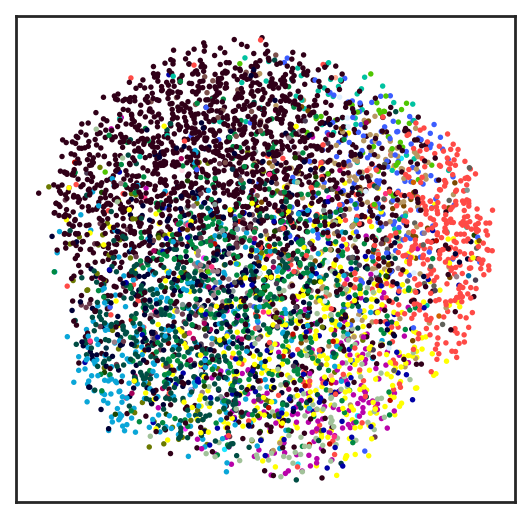

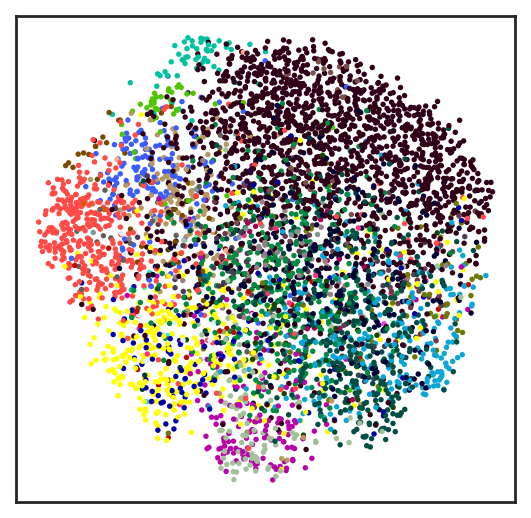

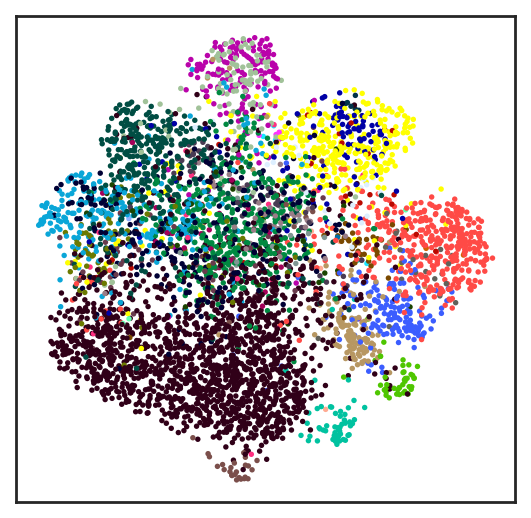

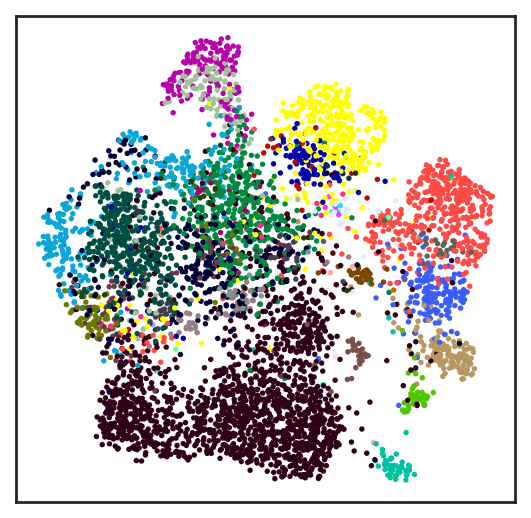

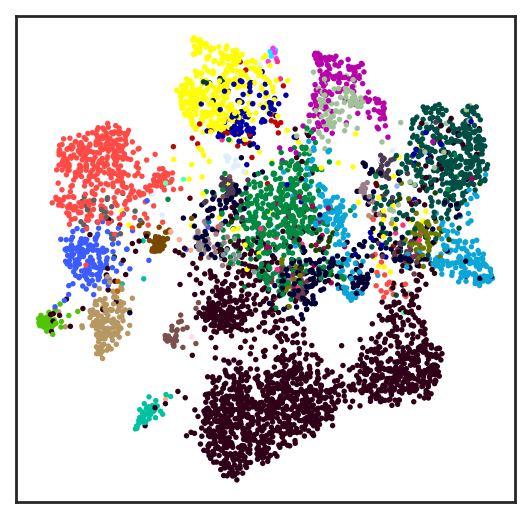

In [113]:
for timestep in [0,300,600,700,800,900,1000]:
    diffused_tis_adata.obsm['x_T{}'.format(timestep)] = intermediate_steps[timestep][diffused_tis_idx,:].numpy()
    sc.pp.neighbors(diffused_tis_adata, use_rep='x_T{}'.format(timestep))
    sc.tl.umap(diffused_tis_adata)
    fig = sc.pl.umap(
        diffused_tis_adata, 
        color = "predicted_cell_type_general", 
        title="Cells colored by (Predicted) Cell Type\nafter {}/1000 Denoising Timesteps".format(timestep), 
        return_fig=True
    )
    ax = fig.axes[0]
    ax.legend_.set_bbox_to_anchor((1.1,0.5))
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umap_{}_diffused_t{}.png".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

    #create version with no text for easier use in illustrator
    ax.legend_.remove()
    ax.set_title("");
    ax.set_xlabel("");
    ax.set_ylabel("");
    plt.savefig("figures/umap/diffused_{}_cells_umaps/umaps_notext/umap_{}_diffused_t{}.pdf".format(tis, tis, timestep), dpi=300, bbox_inches="tight")

# visualize the proportions of true vs predicted cell types across all these patients

In [162]:
diffusion_ct_corrs = {}
diffusion_ct_sims = {}

for tis in ["breast", "blood","lung","heart"]: #"small intestine","kidney","eye","brain",

    tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
    
    # create coarser cell type col
    tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())
    
    diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
    diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]
    
    # create adata for diffused cells. .X holds cells at final timepoint
    diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)
    
    ## assign cell types to generated cells by using a KNN classifier, to use for viz
    
    from sklearn.neighbors import KNeighborsClassifier  
    
    neigh = KNeighborsClassifier(n_neighbors=10)
    neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
    diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
    diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')
    
    # remove unknown cells from true and diffused
    tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]
    diffused_tis_adata = diffused_tis_adata[diffused_tis_adata.obs.predicted_cell_type_general!="unknown"]
    
    true_ct_fracs = tis_adata.obs.drop(columns="cell_type").rename(columns={'cell_type_general':'cell_type'}).groupby('patient_id').cell_type.value_counts(normalize=True).reset_index().pivot(index='patient_id', columns='cell_type', values='proportion').fillna(0)
    diff_ct_fracs = diffused_tis_adata.obs.rename(columns={'predicted_cell_type_general':'cell_type'}).groupby('patient_id').cell_type.value_counts(normalize=True).reset_index().pivot(index='patient_id', columns='cell_type', values='proportion').fillna(0)
    
    x = true_ct_fracs
    y = diff_ct_fracs
    
    # align columns and rows
    x, y = x.align(y, axis=1, join='outer', fill_value=0)
    x, y = x.align(y, axis=0, join='outer', fill_value=0)
    
    #compute corr
    diffusion_ct_corrs[tis] = np.corrcoef(x, y, rowvar=True)
    diffusion_ct_sims[tis] = cosine_similarity(x, y)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndat

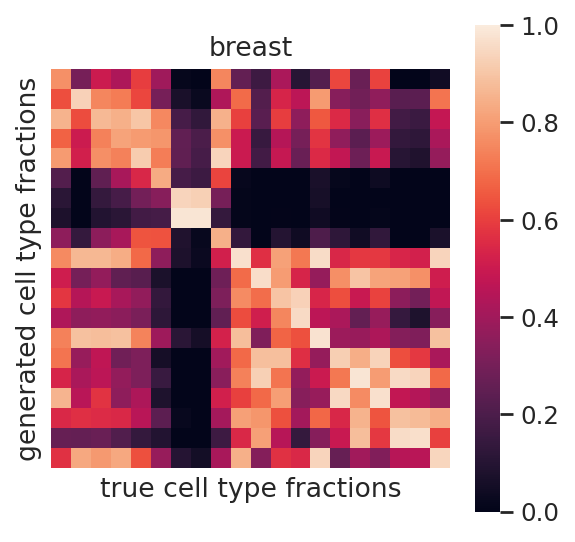

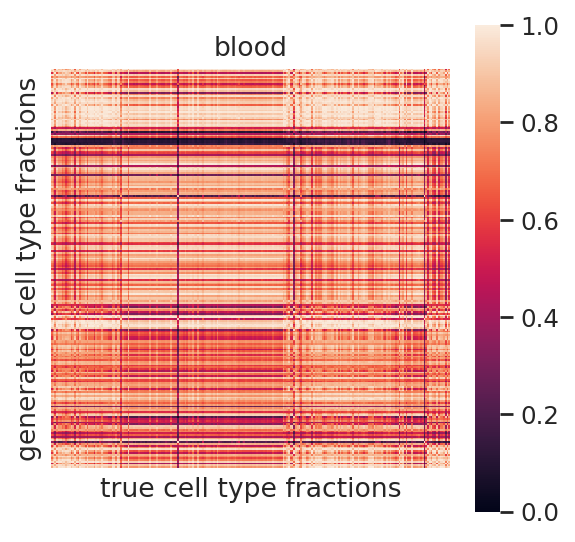

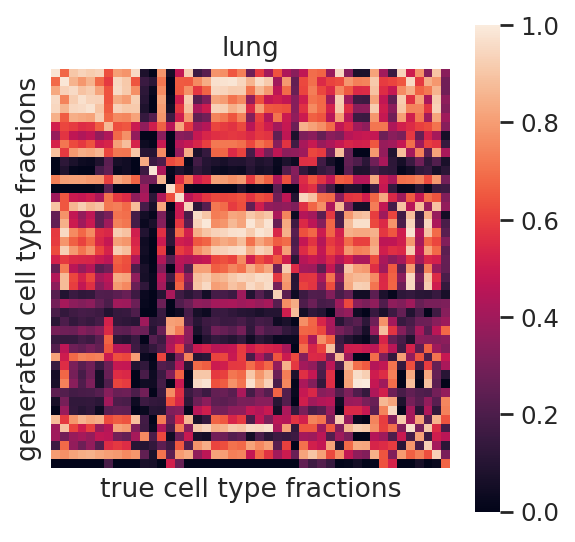

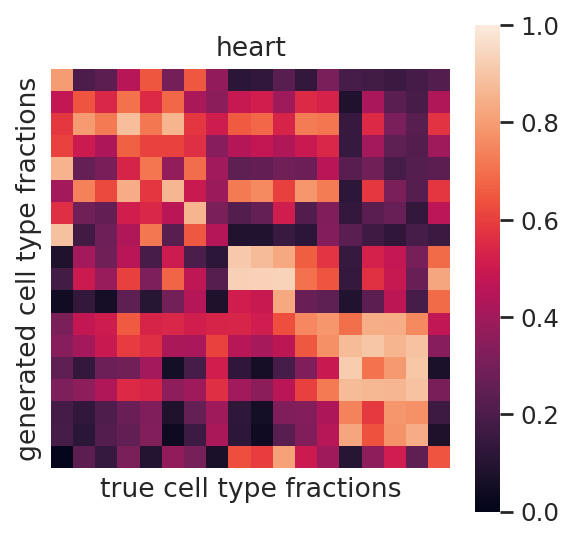

In [164]:
sns.set_theme(style="white")  # Set a clean theme
for tis in ["breast", "blood","lung","heart"]: #"kidney","eye","brain","small intestine",
    NUM_PATIENTS = np.sum(true_adata.obs[['patient_id','tissue_general']].drop_duplicates().tissue_general.isin([tis]))
    ax = sns.heatmap(diffusion_ct_corrs[tis][:NUM_PATIENTS,NUM_PATIENTS:], vmin=0, vmax=1, square=True, xticklabels=False, yticklabels=False)
    ax.set(xlabel="true cell type fractions", ylabel="generated cell type fractions")
    plt.title(tis)
    plt.savefig("figures/{}_truediff_celltypecorrs.pdf".format(tis), dpi=300, bbox_inches="tight")
    plt.savefig("figures/{}_truediff_celltypecorrs.png".format(tis), dpi=300, bbox_inches="tight")
    plt.show()

In [116]:
for tis in ["breast", "blood","lung","heart","kidney","eye","brain","small intestine"]:
    print(tis)
    print(np.sum(true_adata.obs[['patient_id','tissue_general']].drop_duplicates().tissue_general.isin([tis])))

breast
20
blood
224
lung
45
heart
18
kidney
25
eye
10
brain
44
small intestine
13


#### cosine similarity

In [187]:
  

#diffusion_ct_sims = {}
for tis in ["small intestine","kidney","eye","brain","breast", "blood","lung","heart"]:

    tis_adata = true_adata[true_adata.obs.tissue_general.isin([tis])]
    
    # create coarser cell type col
    tis_adata.obs = add_cell_type_general_col_obs(tis_adata.obs.copy())
    
    diffused_tis_idx = np.where(diffused_cell_annots.tissue_general==tis)[0]
    diffused_tis_annots = diffused_cell_annots.iloc[np.where(diffused_cell_annots.tissue_general==tis)[0]]
    
    # create adata for diffused cells. .X holds cells at final timepoint
    diffused_tis_adata = ad.AnnData(intermediate_steps[len(intermediate_steps)-1][diffused_tis_idx,:].numpy(), obs = diffused_tis_annots)
    
    ## assign cell types to generated cells by using a KNN classifier, to use for viz
    
    
    neigh = KNeighborsClassifier(n_neighbors=10)
    neigh.fit(tis_adata.obsm['scvi'], tis_adata.obs['cell_type_general'])
    diffused_tis_adata.obs['predicted_cell_type_general'] = neigh.predict(diffused_tis_adata.X)
    diffused_tis_adata.obs['predicted_cell_type_general'] = diffused_tis_adata.obs['predicted_cell_type_general'].astype('str')
    
    # remove unknown cells from true and diffused
    tis_adata = tis_adata[tis_adata.obs.cell_type_general!="unknown"]
    diffused_tis_adata = diffused_tis_adata[diffused_tis_adata.obs.predicted_cell_type_general!="unknown"]
    
    true_ct_fracs = tis_adata.obs.drop(columns="cell_type").rename(columns={'cell_type_general':'cell_type'}).groupby('patient_id').cell_type.value_counts(normalize=True).reset_index().pivot(index='patient_id', columns='cell_type', values='proportion').fillna(0)
    diff_ct_fracs = diffused_tis_adata.obs.rename(columns={'predicted_cell_type_general':'cell_type'}).groupby('patient_id').cell_type.value_counts(normalize=True).reset_index().pivot(index='patient_id', columns='cell_type', values='proportion').fillna(0)
    
    x = true_ct_fracs
    y = diff_ct_fracs
    
    # align columns and rows
    x, y = x.align(y, axis=1, join='outer', fill_value=0)
    x, y = x.align(y, axis=0, join='outer', fill_value=0)
    
    #compute corr
    diffusion_ct_sims[tis] = cosine_similarity(x, y)

/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/opt/conda/rpeyser/envs/scset_latest/lib/python3.12/site-packages/anndat

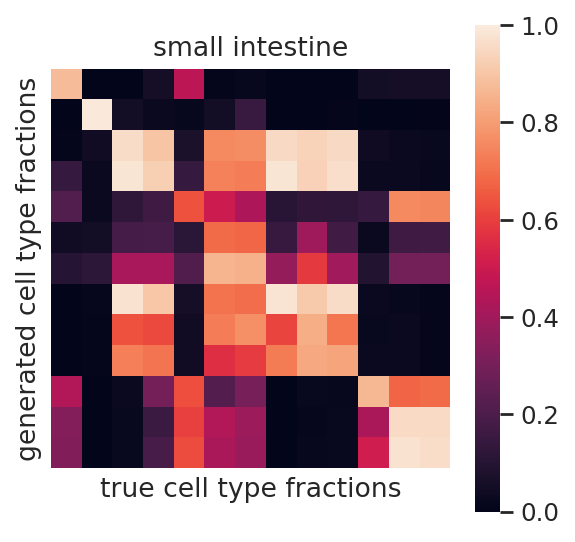

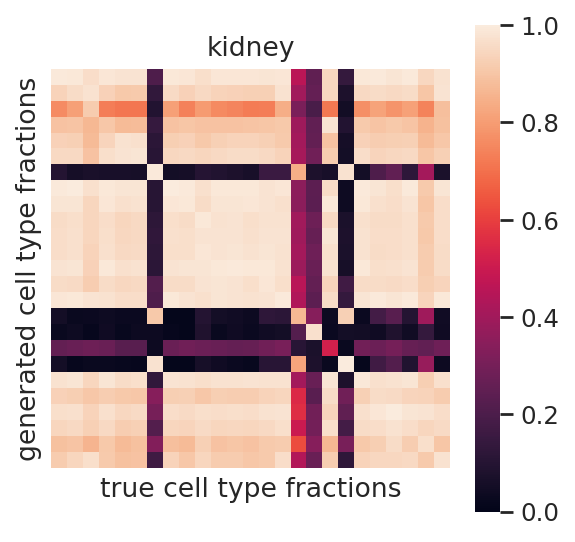

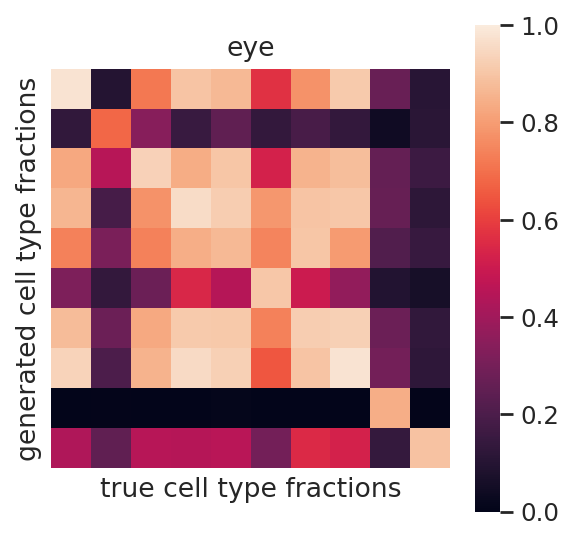

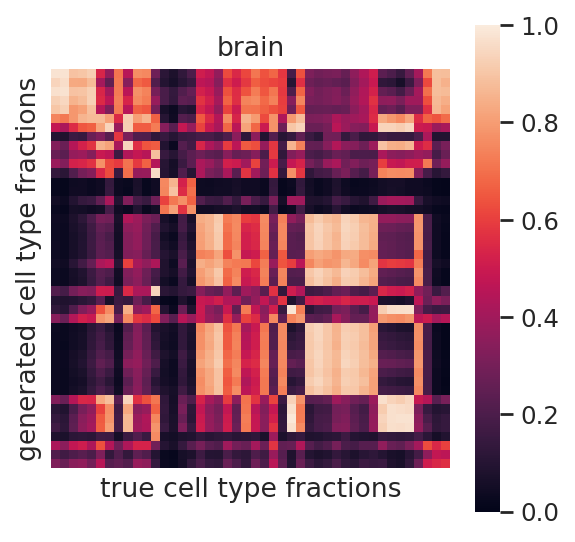

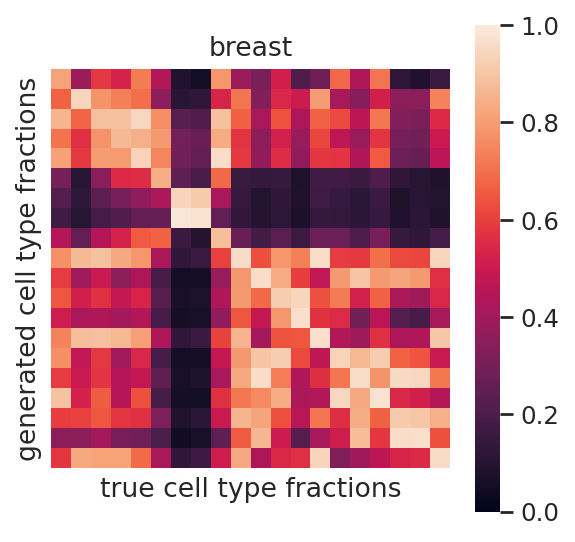

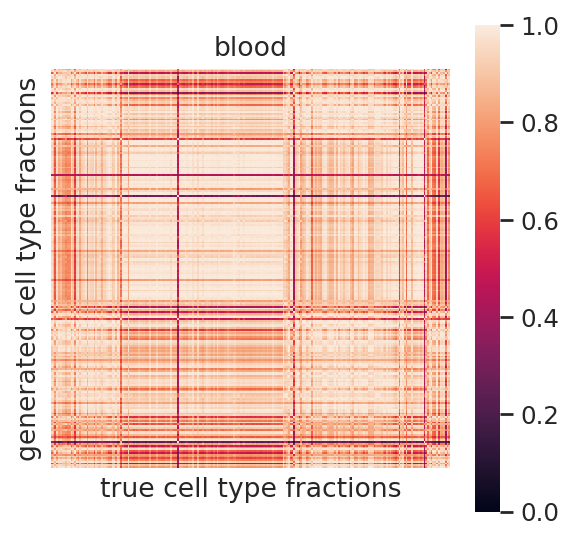

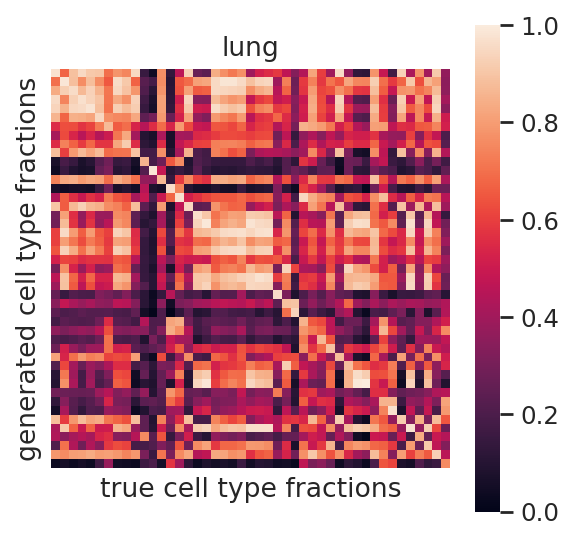

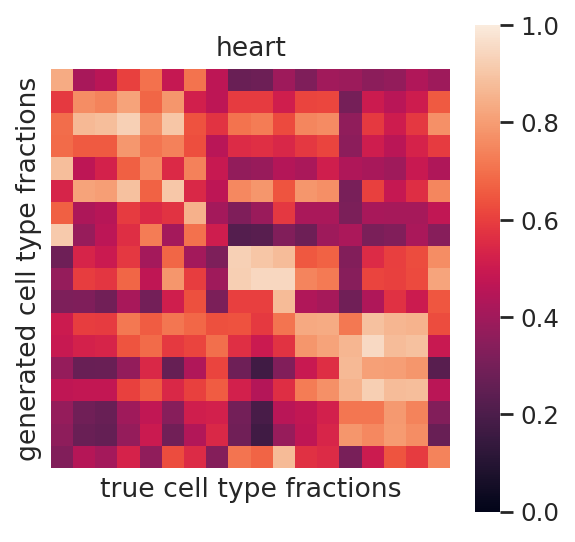

In [188]:
sns.set_theme(style="white")  # Set a clean theme
for tis in ["small intestine","kidney","eye","brain","breast", "blood","lung","heart"]:
    
    ax = sns.heatmap(diffusion_ct_sims[tis], vmin=0, vmax=1, square=True, xticklabels=False, yticklabels=False)
    ax.set(xlabel="true cell type fractions", ylabel="generated cell type fractions")
    plt.title(tis)
    plt.show()